In [1]:
import giraffe
import matplotlib.pyplot as plt
import networkx as nx
from netZooPy.otter.otter import otter
from netZooPy.panda.panda import Panda 
import notebooks
import numpy as np
from numpy.random import default_rng
import pandas as pd
import random
import scipy
from scipy import stats
from sklearn.metrics import roc_curve, auc

In [2]:
cd ..

/Users/soel/Desktop/giraffe/notebooks


## n=25

In [3]:
TF = 100  # Number of transcription factors
G = 500  # Number of genes
n = 25  # Number of samples

def generate_ppi(tf):
    sample_ppi = pd.read_csv('data/sample_data/PPI.csv') #  PPI from human data
    degree = nx.degree_histogram(nx.from_numpy_array(sample_ppi.to_numpy()))
    degree_prob = [d / np.sum(degree) for d in degree] #  Degree distribution for each node
    #  Sample degrees for each node according to distribution observed in real data
    D = random.choices(population = [i for i in range(len(degree_prob))], weights = degree_prob, k = tf)
    G = nx.expected_degree_graph(D) 
    PPI = nx.to_numpy_array(G) #  Create undirected PPI network
    np.fill_diagonal(PPI, 1) #  By definition, transcription factors interact with themselves
    giraffe.utils.check_symmetric(PPI) #  Sanity check
    return PPI

def find_cliques(ppi) :
    """
    Returns a maps from a transcription factor to the id of the cliques it belongs to
    """
    G = nx.from_numpy_array(ppi)
    cliques = {}
    idx = 0
    for i in nx.find_cliques(G):
        if len(i) > 1:
            for protein in i:
                if protein in cliques.keys():
                    cliques[protein] = cliques[protein] + [idx]
                else:
                    cliques[protein] = [idx]
            idx += 1
    # idx: number of cliques in ppi
    # map from transcription factor to its cliques (cliques of size 1 are neglected)
    return idx, cliques

def generate_tfa(ppi, n):
    tf = ppi.shape[0]
    
    cliques_no, cliques = find_cliques(ppi) #  number of cliques and map tf -> cliques_id
    cliques_quantity = np.zeros((n, cliques_no)) #  quantity for each protein complex
    
    #  Generate quantity for each complex
    for i in range(cliques_no) :
        cliques_quantity[:, i] = np.random.uniform(0, .1, n)
    
    # The quantity for each tf is the sum of the cliques it belongs to
    TFA = np.zeros((tf, n))
    for k, v in cliques.items() :
        TFA[k, :] = np.sum(cliques_quantity[:, [v]])
    
    # If a transcription factor is not part of a complex, it can still be active
    for i in range(tf) :
        if np.sum(TFA[i, :]) == 0 :
            TFA[i, :] = np.random.uniform(0, 1, n)
            
    return TFA #  Generated matrix

def generate_regulation(g, tf, ppi, sparsity = .15, a = .5) :
    rng = default_rng()
    rvs = stats.uniform(loc = -a, scale = 2 * a).rvs
    
    R = np.zeros((g, tf)) #  To store the ground-truth regulation matrix
    
    cliques_no, cliques = find_cliques(ppi) #  number of cliques and map tf -> cliques_id
    cliques_to_regulation = np.zeros((g, cliques_no)) #  How much each clique regulates the genes
    
    for i in range(cliques_no) :
        regulation = scipy.sparse.random(g, 1, sparsity, random_state = rng, data_rvs = rvs).A
        cliques_to_regulation[:, i] = regulation.flatten()
    
    for k, v in cliques.items() :
        R[:, k] = np.sum(cliques_to_regulation[:, [v]])
    
    #  If a transcription factor is not part of any clique, it can still regulate gene expression 
    for i in range(tf) :
        if np.sum(R[:, i]) == 0 :
            R[:, i] = scipy.sparse.random(g, 1, sparsity, random_state = rng, data_rvs = rvs).A.flatten()
            
    return R #  Generated matrix

def generate_motif(R, shuffle = .2):
    motif = R.copy()
    motif[motif != 0] = 1
    rng = default_rng()
    rvs = stats.uniform(loc = 1, scale = 0).rvs
    flip = scipy.sparse.random(R.shape[0], R.shape[1], shuffle, random_state = rng, data_rvs = rvs).A
    for i in range(R.shape[0]):
        for j in range(R.shape[1]):
            if flip[i, j] == 0:
                continue
            if motif[i, j] == 0:
                motif[i, j] = 1
            else:
                motif[i, j] = 0
    return motif

def compute_expression(R, TFA, confounder = None) :
    res = R.dot(np.abs(TFA))
    if confounder is None:
        return res
    return res + np.array([confounder for i in range(R.shape[0])])

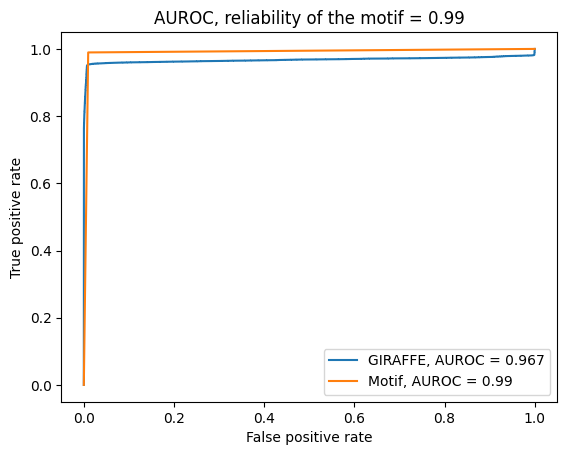

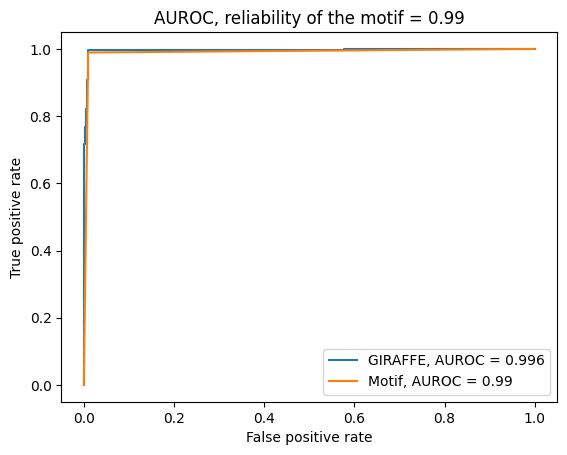

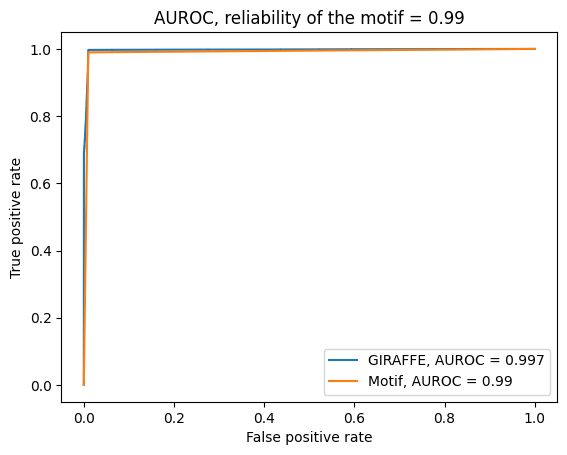

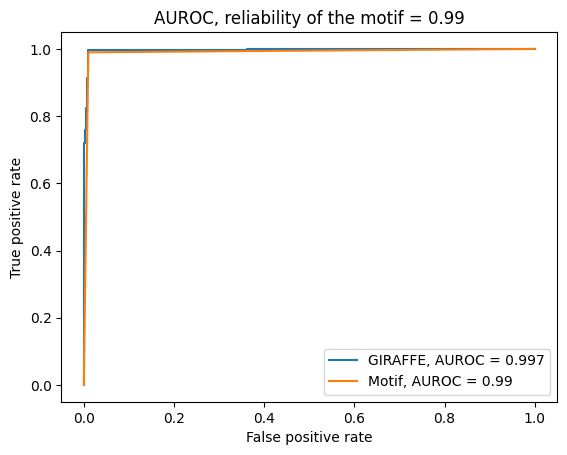

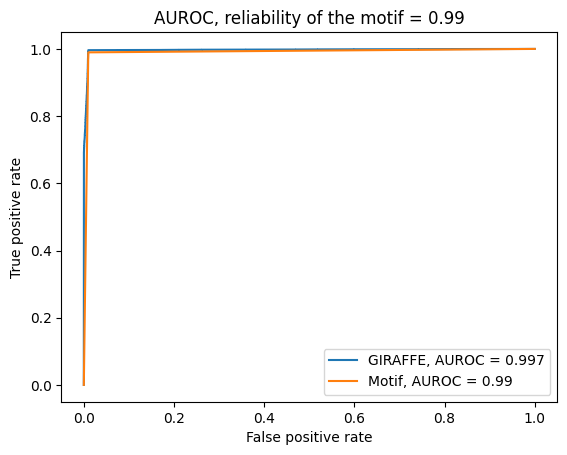

...

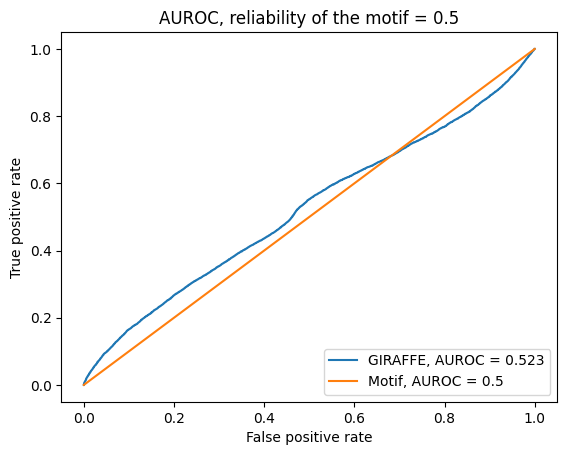

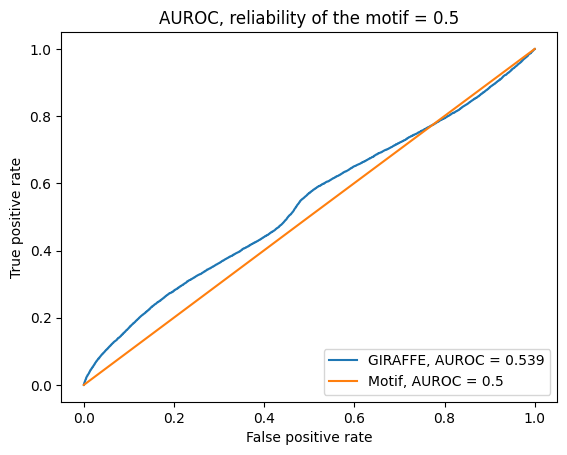

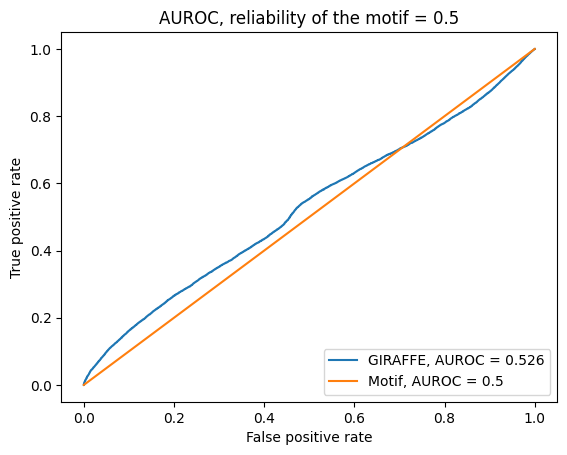

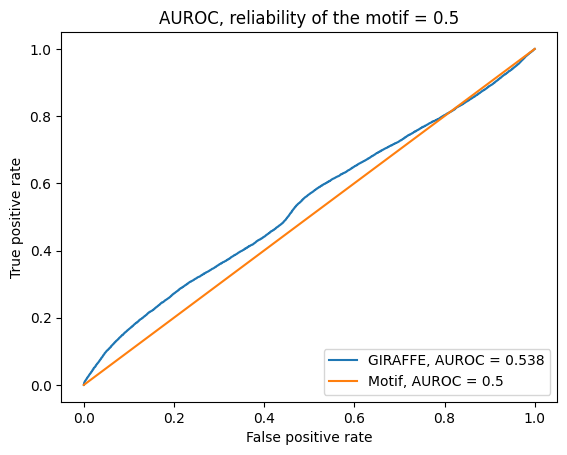

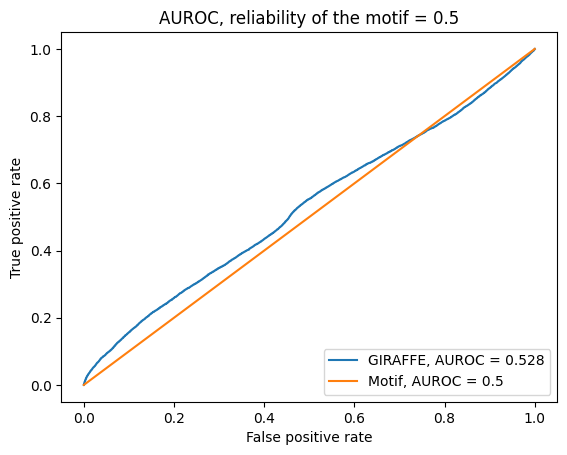

Prior reliability 0.99: mean 0.99622, sd 0.0041918492339300594
Prior reliability 0.9: mean 0.9665799999999999, sd 0.000695413546028549
Prior reliability 0.8: mean 0.92824, sd 0.0009707728879609286
Prior reliability 0.7: mean 0.86588, sd 0.0013658696863171112
Prior reliability 0.6: mean 0.7602400000000001, sd 0.0031148675734290884
Prior reliability 0.5: mean 0.5332, sd 0.006471475874945381


In [6]:
def simulation(n = 25, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    R[R != 0] = 1
    R_giraffe = giraffe.Giraffe(gene_expression, motif.copy(), ppi, lr = 1e-4,).get_regulation()
    return notebooks.plot_auroc(R, [np.abs(R_giraffe), motif], ["GIRAFFE", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 50
res_giraffe = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_giraffe.keys():
            res_giraffe[shuffle] += [score]
        else:
            res_giraffe[shuffle] = [score]

for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_giraffe[shuffle])}, sd {np.std(res_giraffe[shuffle])}")

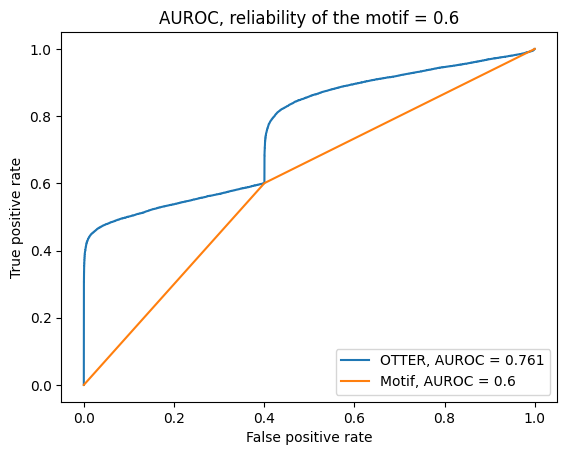

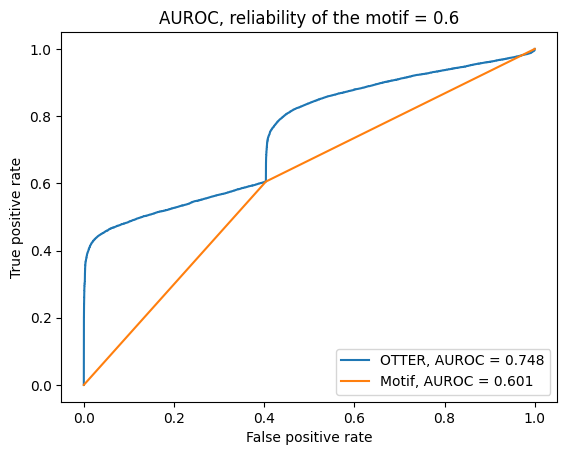

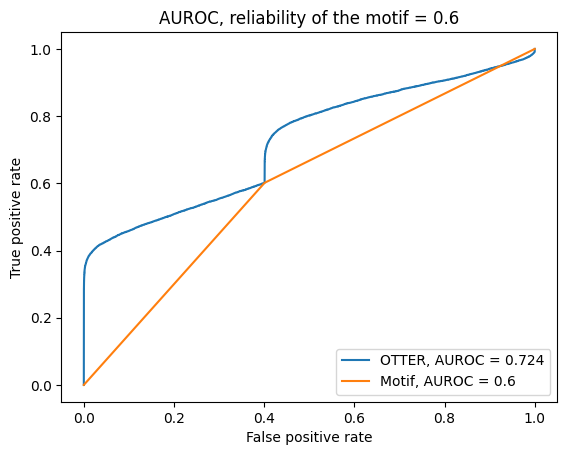

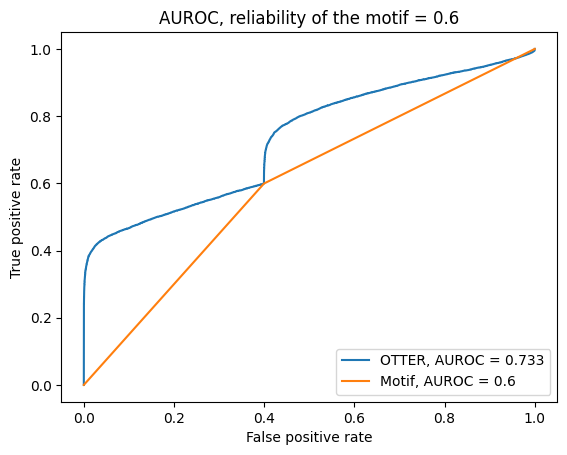

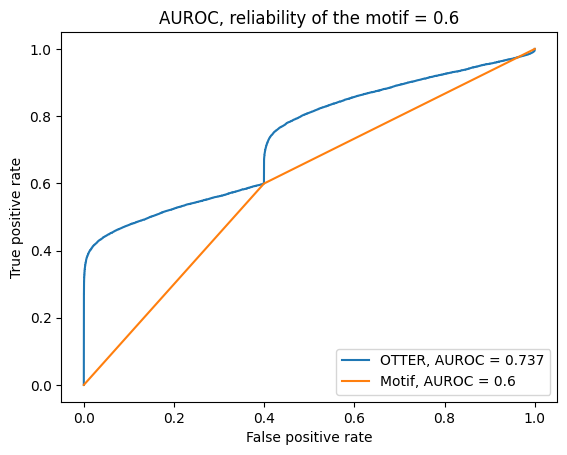

...

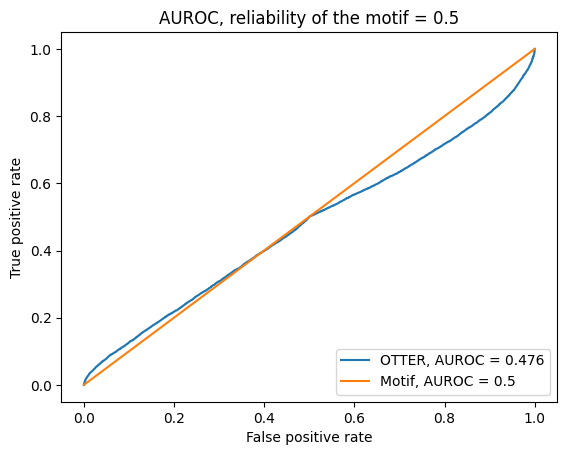

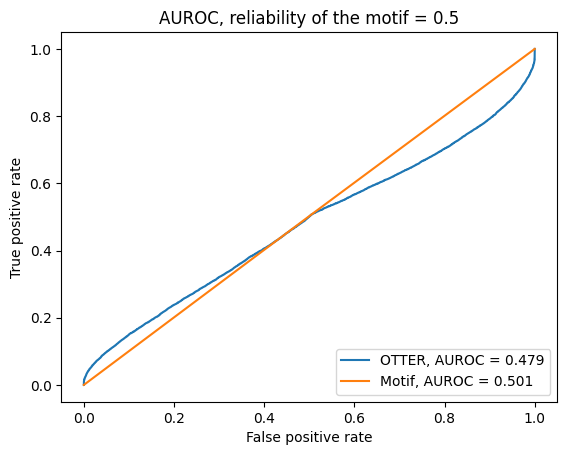

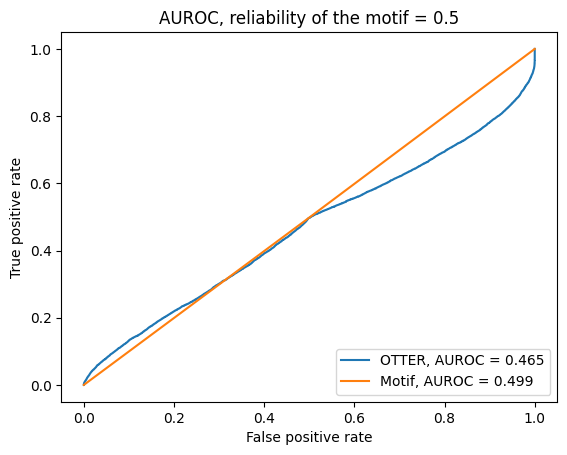

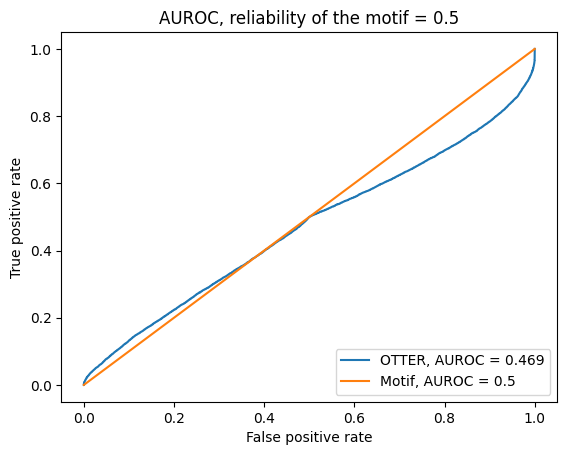

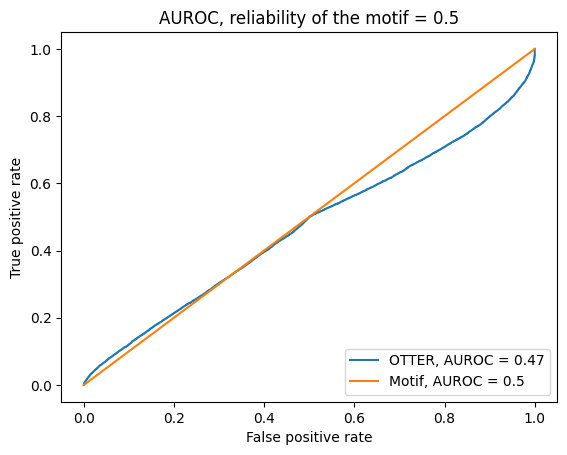

Prior reliability 0.6: mean 0.74052, sd 0.011375834035357593
Prior reliability 0.5: mean 0.4701000000000001, sd 0.007214568594171088


In [16]:
def simulation(n = 25, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    
    R_otter = otter(motif.copy().T, ppi, np.corrcoef(gene_expression), Iter = 200).T
    return notebooks.plot_auroc(R, [R_otter, motif], ["OTTER", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 50
res_otter = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_otter.keys():
            res_otter[shuffle] += [score]
        else:
            res_otter[shuffle] = [score]

for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_otter[shuffle])}, sd {np.std(res_otter[shuffle])}")

In [11]:
for shuffle in shuffling[0:3]:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_otter[shuffle])}, sd {np.std(res_otter[shuffle])}")

Prior reliability 0.99: mean 0.9965, sd 0.0006082762530298225
Prior reliability 0.9: mean 0.9629999999999999, sd 0.0045166359162544896
Prior reliability 0.8: mean 0.9162962962962965, sd 0.0056030072270417995


In [15]:
for shuffle in shuffling[0:1]:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_otter[shuffle])}, sd {np.std(res_otter[shuffle])}")

Prior reliability 0.7: mean 0.849125, sd 0.01136996225440817


0.01
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -162.948613 -162.575914 -162.496290 -162.292494 -163.115062 -162.444370   
1   -162.400347 -161.451273 -160.845695 -161.937257 -163.138268 -161.293170   
2   -162.633334 -162.234743 -163.241979 -162.573064 -161.925627 -162.879807   
3   -161.507957 -162.717820 -162.077452 -161.463696 -162.065412 -162.084568   
4   -162.578784 -163.121203 -162.588480 -162.605010 -163.493296 -162.216733   
..          ...         ...         ...         ...         ...         ...   
495 -164.733519 -165.196157 -163.778396 -165.479123 -163.958020 -164.406207   
496 -163.929679 -163.610821 -163.291613 -162.560135 -163.497

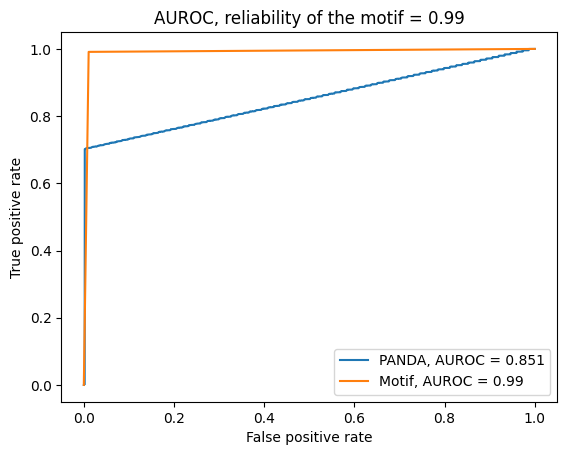

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 218
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    377.541500  377.280266  376.113275  377.289359  377.163749  377.642052   
1    377.563935  379.222255  378.721617  378.927508  378.836697  378.208831   
2    378.904933  379.140989  379.808216  379.638459  379.317336  380.017326   
3    378.993557  379.411144  378.964364  379.056373  378.828895  379.507663   
4    377.074917  377.284439  376.848496  378.291040  378.101212  376.939486   
..          ...         ...         ...         ...         ...         ...   
495  378.932636  379.536013  379.127149  379.603680  378.704592  378.509166   
496  379.161211  379.500094  379.336315  380.009408  380.316973  

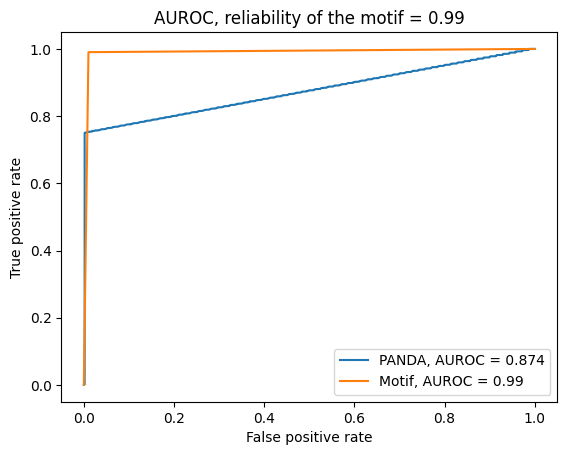

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 246
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.07 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt               0            1            2            3            4   \
0    1175.096141  1176.341898  1175.371760  1175.602470  1175.355222   
1    1175.181439  1174.584888  1173.984726  1174.441641  1174.674243   
2    1173.392592  1173.944269  1173.115269  1173.985657  1173.664880   
3    1173.718805  1174.560696  1174.237535  1175.002747  1174.075734   
4    1173.069870  1172.403385  1173.494678  1173.467539  1173.941790   
..           ...          ...          ...          ...          ...   
495  1173.935250  1173.896301  1172.307656  1173.965908  1173.724806   
496  1173.996936  1176.062503  1174.094377  1174.000887  1173.642797   
497  1173.712983  1173.818011  1174.186840  1174.

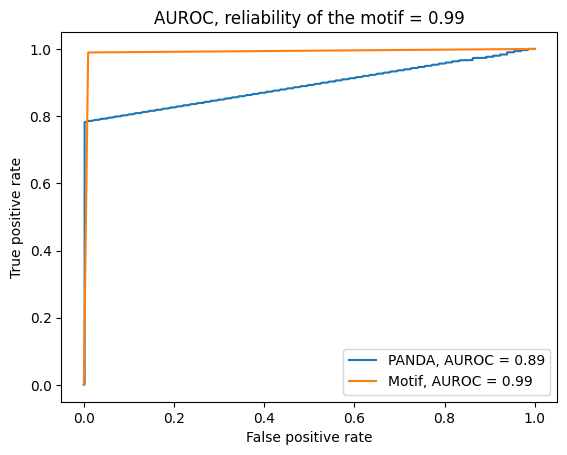

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    12.698054  12.489605  11.344392  11.774093  12.722583  12.570133   
1    11.876572  13.029449  12.861875  12.525325  10.807710  12.783632   
2    11.422120  11.289230  11.607621  11.762648  11.777713  13.322927   
3    10.656086  10.967238   9.954930  10.214716  10.365340  10.418373   
4    10.723758  10.860042  10.577059  10.953877  11.153165  10.658281   
..         ...        ...        ...        ...        ...        ...   
495   9.070039   9.257816   9.404407   9.115504  10.599021   8.986571   
496   9.322474  11.043237  10.233928   9.664694  10.893490  10.513283   
497  13.433123  12.830990  12.556781  12

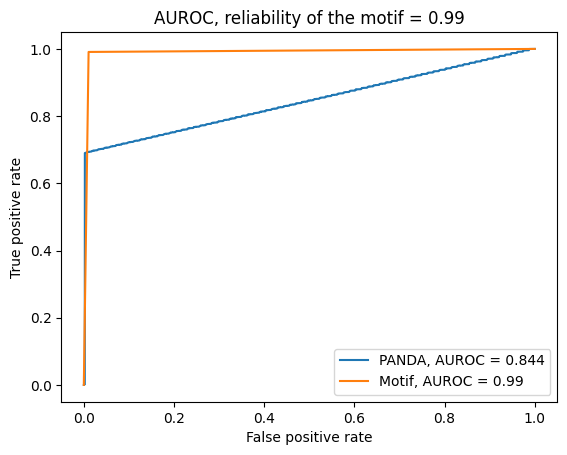

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -347.819692 -347.885888 -348.612903 -348.187759 -347.714538 -347.983178   
1   -347.494512 -347.818327 -349.119729 -348.434347 -347.440126 -348.347950   
2   -350.342598 -350.177929 -351.291370 -351.316808 -350.699860 -351.675060   
3   -349.949542 -350.979207 -351.470681 -351.223080 -351.701236 -350.869498   
4   -347.995935 -348.517849 -349.450712 -349.186391 -348.496461 -349.715726   
..          ...         ...         ...         ...         ...         ...   
495 -351.939877 -350.319169 -349.943974 -350.873212 -350.204956 -351.725306   
496 -348.712904 -348.985306 -349.540102 -348.658325 -349.378744 -

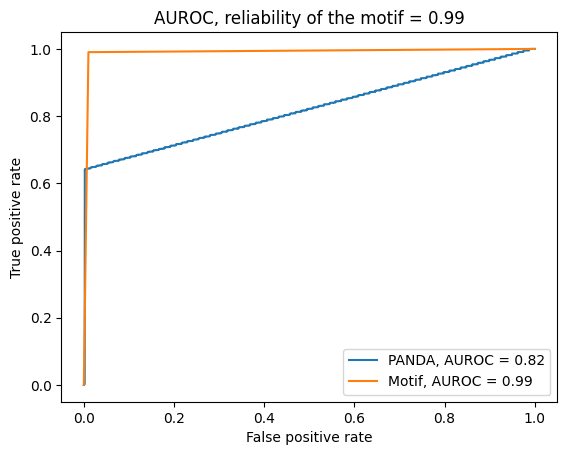

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    922.996445  923.770249  922.532753  923.035606  922.490909  922.398550   
1    921.212473  922.271411  922.938692  922.267441  921.459626  922.272561   
2    921.571279  922.136493  921.879224  921.595997  921.616032  921.647799   
3    923.880163  924.063702  924.155161  924.241581  923.667312  922.388006   
4    923.186205  922.580893  923.125302  922.692958  923.205592  923.445098   
..          ...         ...         ...         ...         ...         ...   
495  924.655182  924.729422  924.795522  924.163755  923.577740  923.451858   
496  920.928661  921.753578  921.232772  921.546427  921.621018  

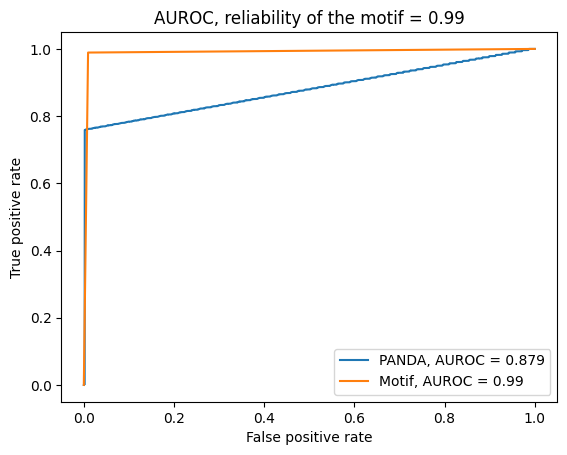

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 210
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.04 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0   -93.669887 -92.368367 -92.281143 -92.736520 -92.856129 -92.339161   
1   -90.133151 -90.897813 -89.840085 -90.384098 -90.879791 -91.408429   
2   -90.093474 -90.139622 -89.914247 -90.568491 -90.268793 -91.576403   
3   -91.918133 -91.008516 -90.818153 -91.198999 -90.635205 -91.669796   
4   -91.114674 -91.814632 -91.226262 -91.280508 -90.991627 -91.030959   
..         ...        ...        ...        ...        ...        ...   
495 -90.178565 -91.264463 -90.238769 -90.799804 -89.687751 -88.833116   
496 -89.943768 -90.350760 -90.643333 -91.298653 -91.862977 -91.532313   
497 -90.286659 -89.959783 -90.017496 -89

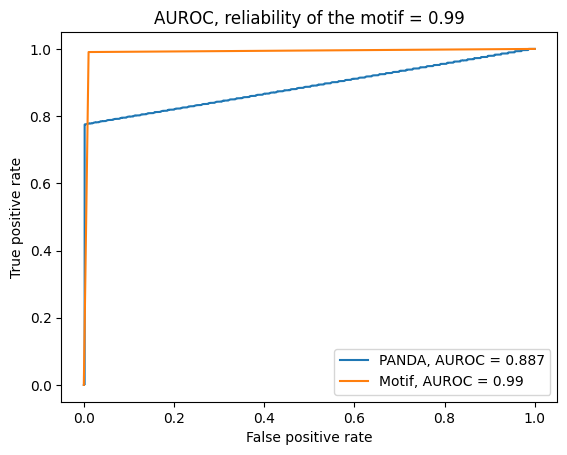

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 148
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -511.922378 -510.128437 -511.101106 -510.130302 -510.709476 -511.337153   
1   -513.382987 -511.668833 -513.051135 -512.315022 -512.361721 -512.908285   
2   -512.748950 -512.295751 -513.273846 -513.654214 -512.808042 -512.812318   
3   -514.616539 -514.530945 -513.531832 -514.192004 -514.537304 -513.168386   
4   -511.638826 -511.817405 -512.396102 -510.687988 -511.514135 -512.043582   
..          ...         ...         ...         ...         ...         ...   
495 -510.545650 -511.320654 -510.118669 -511.398472 -511.410487 -511.893986   
496 -512.515051 -511.754815 -513.067278 -513.926866 -513.431549 -

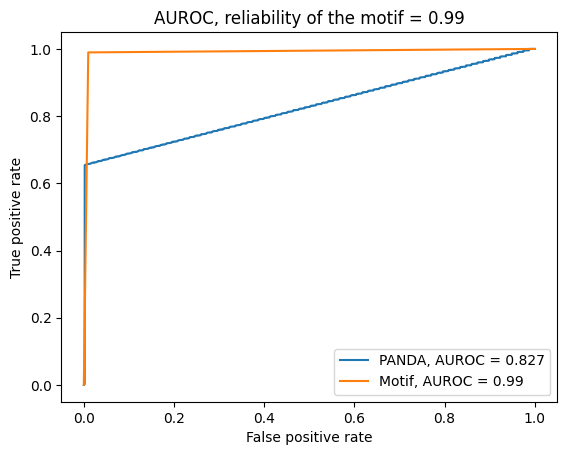

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 208
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.03 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -146.326644 -146.616442 -146.149572 -145.741151 -145.780038 -145.983394   
1   -146.934249 -145.843928 -145.608348 -146.933586 -146.980689 -146.491971   
2   -147.982177 -148.250170 -148.137606 -148.000826 -147.516950 -146.148646   
3   -146.013032 -145.779873 -147.475609 -146.073876 -144.683880 -146.813478   
4   -148.330950 -147.465715 -147.515200 -147.360525 -147.296015 -148.135391   
..          ...         ...         ...         ...         ...         ...   
495 -147.196194 -148.697429 -147.602628 -147.445868 -147.340844 -148.533441   
496 -148.214725 -148.844400 -148.747040 -148.641812 -149.419850 -

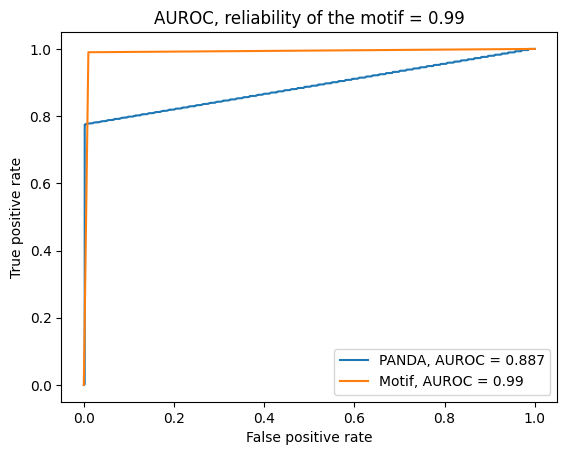

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    155.343646  155.137708  154.666782  154.853602  154.697438  155.700929   
1    156.086198  155.616836  155.407019  155.885968  156.155373  155.119123   
2    156.555951  155.953486  156.207449  155.836373  155.067086  156.120927   
3    155.823732  154.916427  155.687000  155.570049  155.246124  155.728913   
4    156.147438  156.564777  156.415399  156.845318  156.406970  157.169875   
..          ...         ...         ...         ...         ...         ...   
495  155.192885  155.337154  154.984482  155.736465  155.589293  155.450789   
496  157.157724  156.179934  157.726515  157.606282  156.817153  

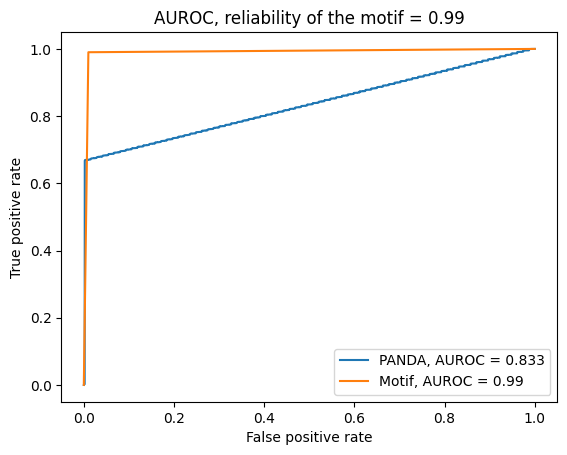

0.1
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    630.013567  630.548264  630.973697  631.289154  630.563039  631.483687   
1    631.615717  631.971015  632.131691  631.504497  631.659294  631.441015   
2    629.875231  629.608858  629.691765  630.131865  630.308212  630.972379   
3    632.494658  631.781455  631.894916  631.665871  630.949475  631.807252   
4    630.057292  630.575743  629.775285  630.275613  630.761249  629.340339   
..          ...         ...         ...         ...         ...         ...   
495  630.553236  630.539980  630.488855  630.614721  631.014324  631.519562   
496  628.755800  628.314768  630.147293  630.058653  629.2160

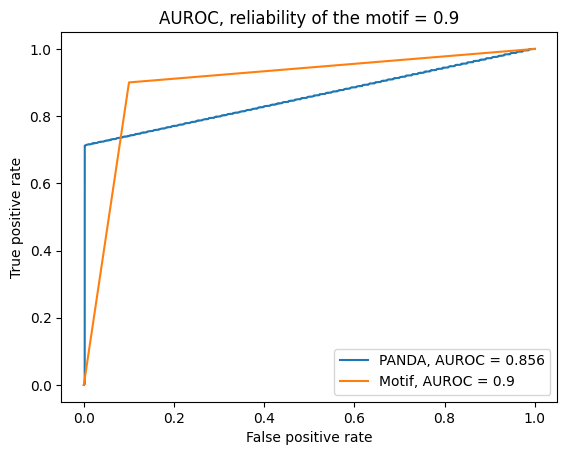

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -422.030247 -422.421946 -421.694868 -421.938914 -421.643115 -422.853902   
1   -422.939147 -424.248108 -423.286538 -422.784055 -422.742632 -424.525490   
2   -421.708304 -422.494668 -424.013915 -423.290679 -422.852667 -422.029112   
3   -421.497816 -421.496170 -421.969998 -420.057696 -421.667395 -419.747666   
4   -423.301308 -423.257923 -423.685550 -423.461170 -422.943657 -423.672217   
..          ...         ...         ...         ...         ...         ...   
495 -422.372411 -421.886467 -421.870712 -422.273600 -423.333747 -421.606563   
496 -423.867435 -424.064773 -423.684844 -422.413387 -422.902911 -

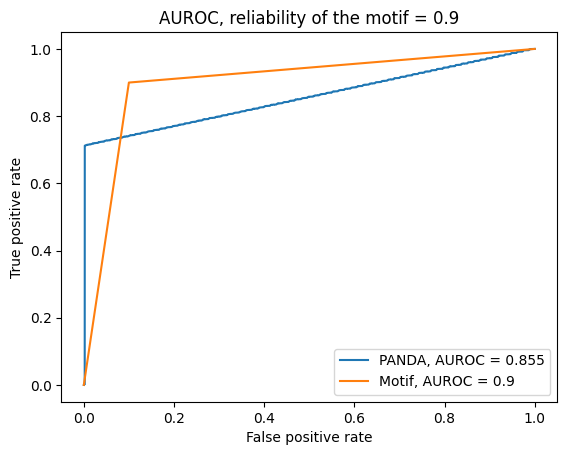

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.03 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -191.235832 -190.976582 -190.343626 -190.131677 -190.961456 -190.322154   
1   -189.998301 -190.590020 -191.300364 -190.380579 -190.665859 -190.603434   
2   -190.534450 -190.032009 -190.367253 -190.786131 -190.661008 -190.322347   
3   -190.599483 -190.160137 -191.361739 -190.279589 -190.358866 -189.989673   
4   -193.486347 -191.882463 -192.312321 -191.858298 -192.029936 -192.699789   
..          ...         ...         ...         ...         ...         ...   
495 -191.650691 -191.416780 -191.025727 -190.455791 -190.633530 -191.279773   
496 -191.276063 -191.235968 -191.284700 -190.382003 -190.746600 -

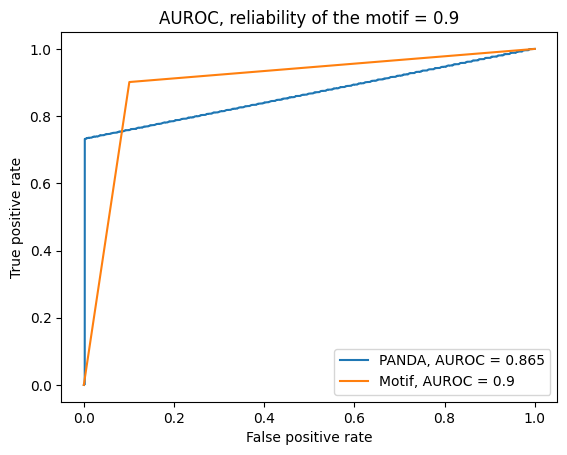

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    564.490413  564.509453  564.672096  564.651315  564.628558  564.751448   
1    564.373939  565.966934  563.615268  564.499184  564.019908  564.634516   
2    564.698394  564.922532  564.025043  564.617669  565.144397  564.210738   
3    565.318046  564.288973  565.061005  564.824152  565.258959  565.194017   
4    563.439949  563.278080  563.133782  564.113446  563.521498  563.268823   
..          ...         ...         ...         ...         ...         ...   
495  564.152627  564.356841  564.559772  564.796239  564.186394  564.674237   
496  564.157722  563.772749  564.635882  564.229290  564.109068  

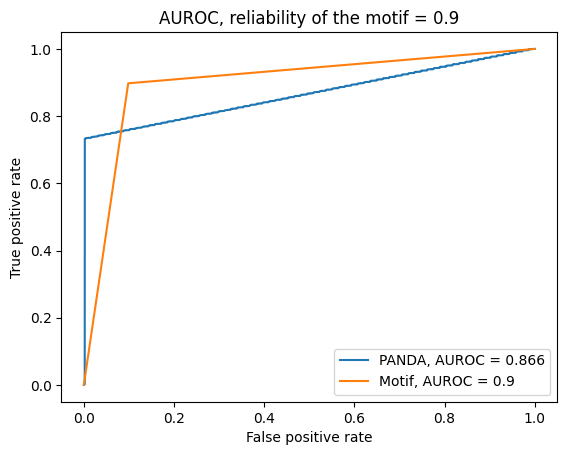

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    344.402380  345.152006  345.051249  344.398635  344.004308  343.632305   
1    345.347681  346.476740  345.589039  346.076246  345.215726  345.856607   
2    343.848966  344.804329  344.002195  344.881615  343.939032  344.006867   
3    346.818968  346.456805  346.239734  346.408226  346.537917  345.720943   
4    345.513209  346.894645  346.265346  345.961880  345.379416  345.715653   
..          ...         ...         ...         ...         ...         ...   
495  345.633275  344.580444  344.927266  344.348479  345.454284  344.971739   
496  346.032485  346.301019  346.554782  345.942150  345.894842  

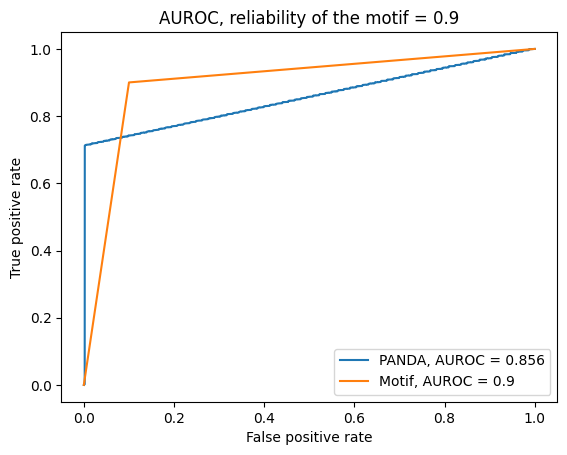

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    135.394548  135.229133  135.532690  135.105815  135.355917  135.080751   
1    134.464002  134.527867  135.136749  135.380220  134.903374  135.035677   
2    136.524928  136.879037  136.170831  136.037120  135.840296  135.986025   
3    135.751579  136.254104  136.544709  134.015023  135.050828  135.548108   
4    137.194724  136.858047  135.767503  138.005842  135.849035  136.326544   
..          ...         ...         ...         ...         ...         ...   
495  135.821171  135.465960  135.046384  134.546890  135.443463  136.028532   
496  135.277766  136.781268  137.964906  136.962619  136.857302  

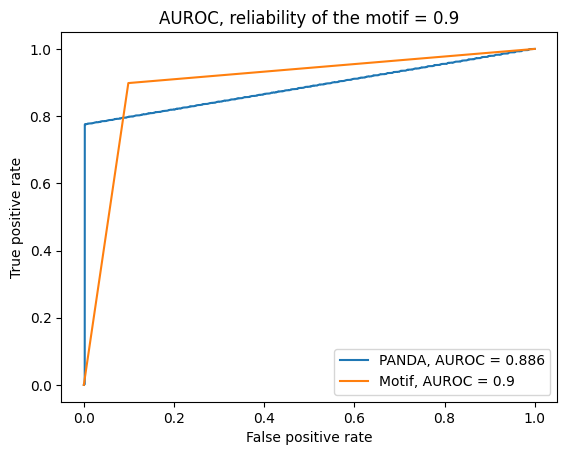

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -727.222595 -726.684129 -726.329128 -727.003512 -727.008646 -726.530569   
1   -727.695044 -727.233887 -726.960568 -726.812601 -727.188907 -727.414227   
2   -727.027830 -725.571192 -726.491952 -727.277461 -725.960386 -726.705443   
3   -726.060398 -726.459687 -726.844275 -725.970345 -726.451064 -726.483091   
4   -728.451394 -726.854104 -728.252055 -727.160253 -726.717065 -726.598897   
..          ...         ...         ...         ...         ...         ...   
495 -726.580593 -727.010442 -726.358093 -726.717871 -726.215053 -726.523502   
496 -726.467664 -726.362559 -727.442133 -726.914856 -725.812343 -

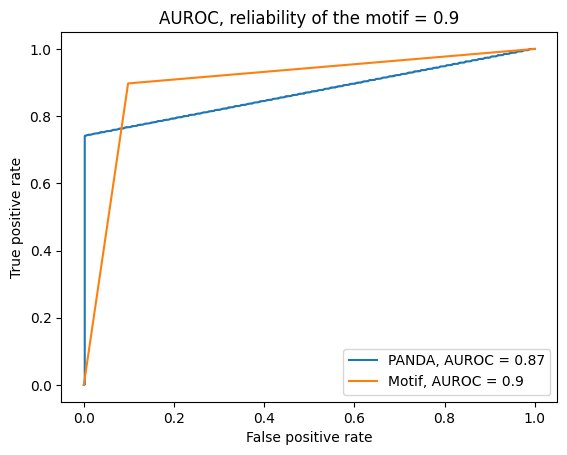

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -128.581467 -126.883219 -127.337526 -126.602631 -126.666027 -127.480225   
1   -129.213505 -129.578789 -129.108276 -128.369059 -128.405918 -128.850051   
2   -127.717344 -127.706131 -128.675218 -128.294090 -128.853483 -127.901336   
3   -127.326495 -127.826020 -128.135150 -128.091271 -127.644001 -128.582080   
4   -126.062178 -127.766685 -128.010606 -126.589886 -126.980166 -126.164163   
..          ...         ...         ...         ...         ...         ...   
495 -126.892833 -128.476836 -127.461301 -126.671667 -127.482475 -125.873300   
496 -126.810229 -128.214109 -127.874949 -127.120975 -127.339144 -

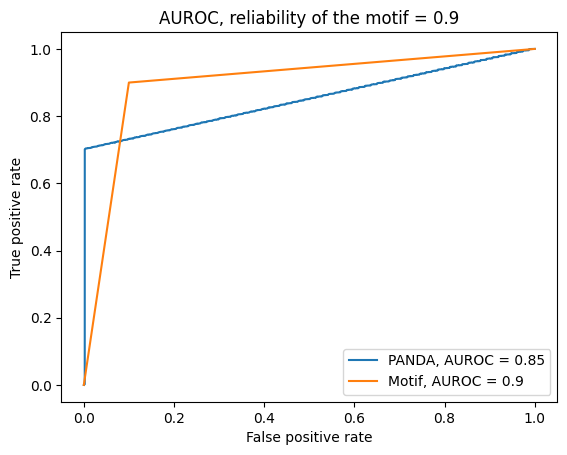

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    129.011444  128.008697  128.524202  127.878665  127.864168  128.778075   
1    129.892536  129.223878  129.361744  129.284550  128.449382  129.876495   
2    130.466653  129.844029  130.390478  129.989009  129.519152  130.180093   
3    128.973922  127.980738  128.820482  128.304364  127.932468  129.127785   
4    128.619338  128.679770  128.456127  127.662582  128.925520  127.958516   
..          ...         ...         ...         ...         ...         ...   
495  129.263359  130.459969  128.194963  128.828384  128.964210  129.732622   
496  128.258631  128.733476  128.173150  128.242552  128.626397  

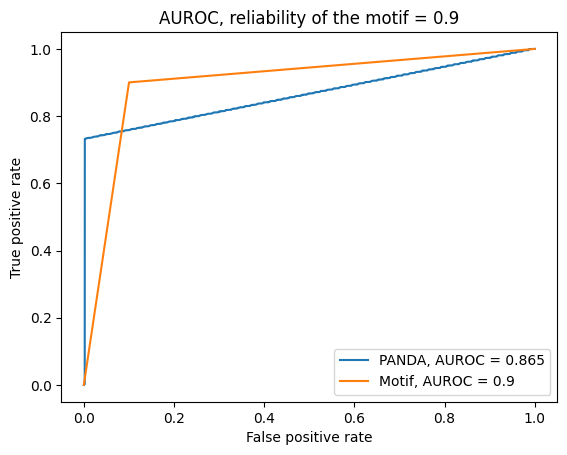

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -341.757917 -342.535946 -341.194031 -341.413486 -342.549284 -342.166989   
1   -340.127371 -341.096759 -342.656461 -341.586965 -341.542762 -341.515387   
2   -338.951120 -338.968957 -338.911258 -338.573795 -339.828681 -338.741065   
3   -341.538192 -342.237119 -341.714251 -342.407200 -342.810657 -340.962849   
4   -341.575435 -339.339715 -340.132306 -340.482017 -340.168652 -341.024145   
..          ...         ...         ...         ...         ...         ...   
495 -340.604136 -339.557077 -340.838988 -340.397288 -341.244096 -339.637727   
496 -340.466389 -341.163205 -340.888742 -341.251811 -340.515554 -

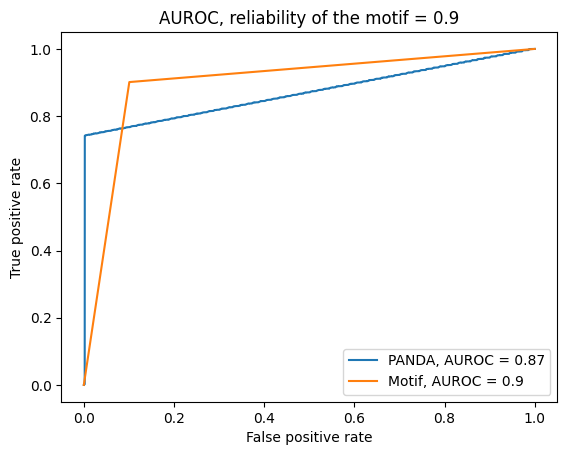

0.2
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -370.435649 -369.177864 -369.006694 -369.627164 -369.421485 -369.062731   
1   -370.781993 -370.123081 -370.302067 -369.966159 -370.598370 -370.287519   
2   -370.221422 -368.947067 -370.179310 -369.338644 -368.432217 -369.052175   
3   -370.296098 -370.625690 -372.205582 -370.453869 -371.354069 -369.808587   
4   -370.473325 -370.584897 -370.554048 -371.671734 -370.370645 -370.229740   
..          ...         ...         ...         ...         ...         ...   
495 -370.482955 -370.576693 -370.762978 -370.922931 -370.672250 -370.762480   
496 -370.862086 -369.776141 -369.464247 -370.588177 -370.1836

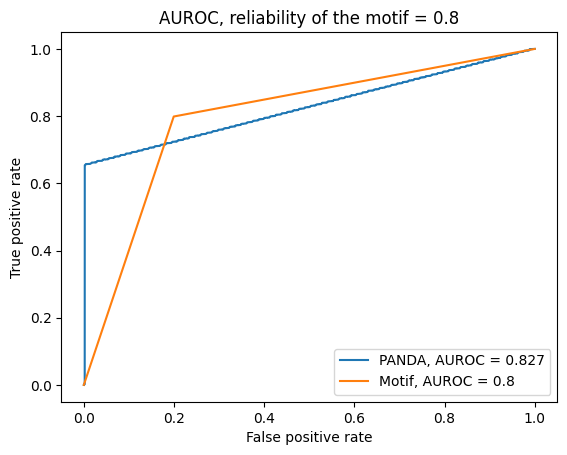

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    131.633980  131.377757  131.802839  131.988539  131.953889  131.004267   
1    130.834100  131.357787  130.558577  130.510056  130.269841  130.150525   
2    131.090140  129.656974  130.099802  130.424793  130.321836  130.697787   
3    131.856950  131.528006  131.979645  131.809539  131.032613  131.479860   
4    132.565729  132.936707  133.615241  133.582593  133.384639  133.930011   
..          ...         ...         ...         ...         ...         ...   
495  133.229016  133.056864  133.253238  133.174363  133.084418  133.315954   
496  130.851190  129.460719  130.182969  130.072874  129.089892  

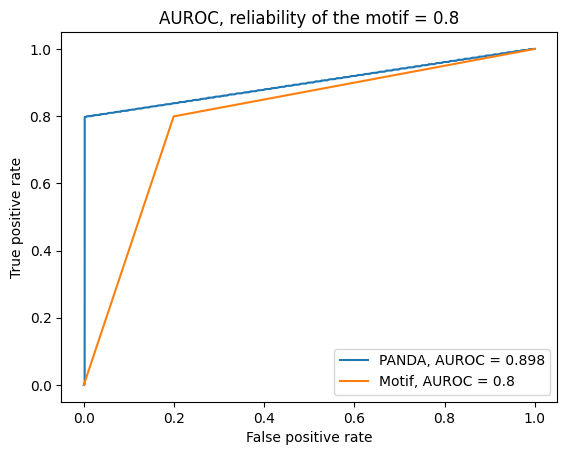

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.03 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -546.044217 -547.476586 -547.225697 -547.530826 -546.129274 -546.082278   
1   -545.757672 -545.742039 -545.568393 -545.539753 -545.761535 -545.386552   
2   -544.228070 -544.252750 -544.264647 -543.798787 -544.634229 -544.066556   
3   -545.167682 -546.160073 -546.209985 -546.039364 -546.101677 -545.046275   
4   -544.373302 -546.316529 -545.506658 -545.781952 -546.679868 -546.064735   
..          ...         ...         ...         ...         ...         ...   
495 -543.614162 -543.947184 -544.115375 -545.463605 -543.532526 -545.237245   
496 -545.908626 -544.207221 -545.476143 -544.311295 -544.345569 -

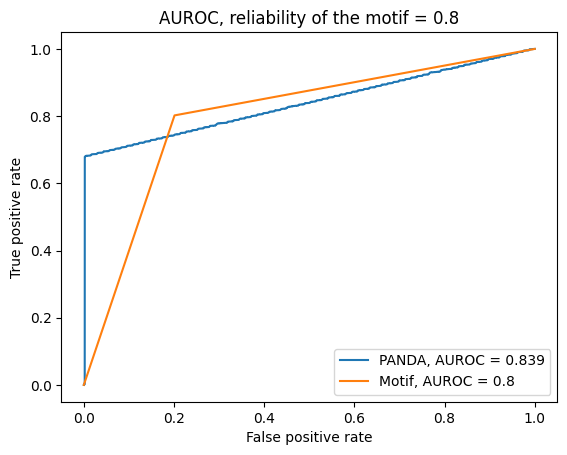

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 208
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    941.100241  940.646116  940.500625  942.116061  941.048472  941.896002   
1    944.865328  944.003040  943.974092  944.344903  944.400248  944.822101   
2    941.339602  942.045580  941.210919  941.490080  942.730867  942.400597   
3    943.157763  942.525584  944.466373  943.891993  943.617975  943.788704   
4    944.806007  944.587449  943.970918  944.192929  944.217024  945.175032   
..          ...         ...         ...         ...         ...         ...   
495  941.706678  941.013259  942.445039  941.398077  941.796102  941.337901   
496  942.787135  943.177181  943.579883  943.139107  943.136247  

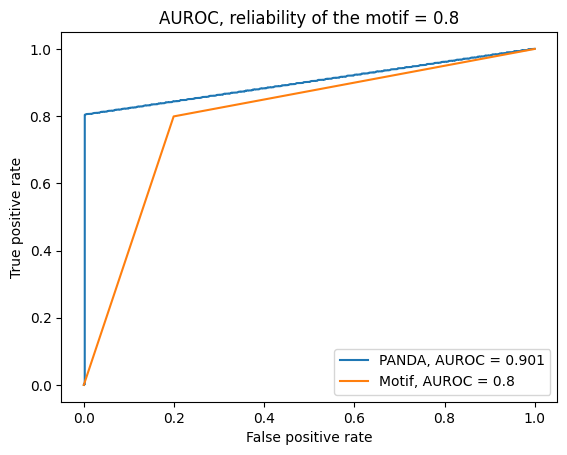

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -300.869589 -300.988374 -300.134959 -301.511032 -301.408174 -300.628498   
1   -301.436297 -301.761895 -302.031416 -301.989800 -302.697228 -301.463633   
2   -299.663774 -300.337673 -300.027439 -299.137756 -299.664445 -300.166979   
3   -301.346005 -300.792731 -301.160211 -300.880068 -301.303255 -300.918533   
4   -299.741727 -300.999102 -299.259316 -301.194437 -300.671998 -300.488735   
..          ...         ...         ...         ...         ...         ...   
495 -303.473156 -303.931887 -304.155129 -304.648674 -302.689065 -303.473135   
496 -301.973994 -301.465485 -301.618860 -302.633174 -302.039073 -

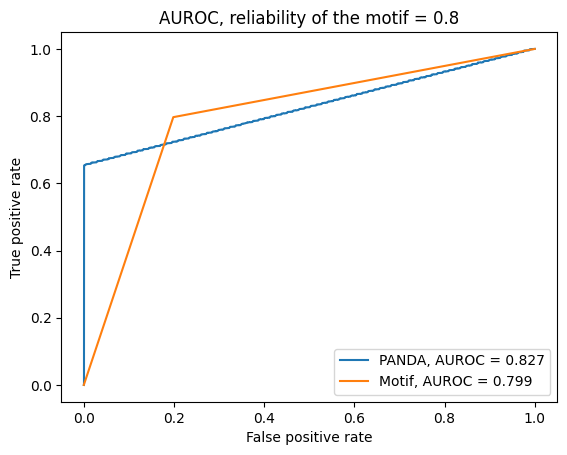

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -204.919486 -206.380925 -204.707423 -204.765259 -205.548555 -205.250630   
1   -207.098155 -206.368789 -206.062005 -207.485670 -207.444423 -205.542669   
2   -208.678717 -208.100241 -207.887214 -207.742229 -208.010685 -208.301325   
3   -205.916258 -206.874455 -207.132690 -206.523894 -206.199400 -207.310359   
4   -205.558126 -205.412695 -206.753117 -205.419563 -206.105716 -206.077341   
..          ...         ...         ...         ...         ...         ...   
495 -208.452480 -208.224282 -208.143723 -209.254856 -208.273788 -208.171510   
496 -207.034071 -206.646278 -208.086115 -207.877610 -206.780065 -

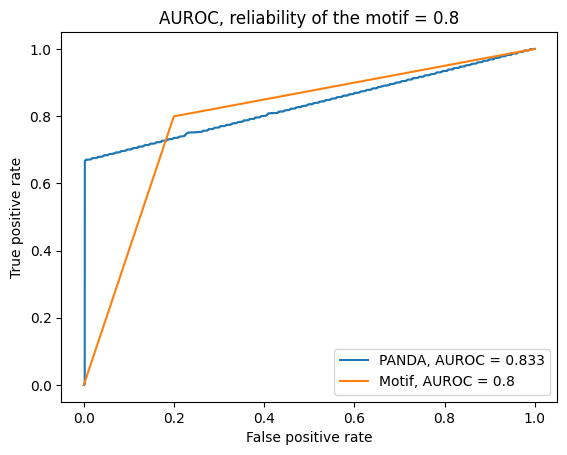

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    226.055266  225.719260  226.521241  226.637114  226.559825  226.857748   
1    226.287612  225.735779  226.575719  226.264768  226.182590  226.911213   
2    225.081231  224.424512  224.030738  223.637285  225.002023  224.368712   
3    226.898314  225.311823  226.214343  226.095060  225.824844  225.916489   
4    225.420631  226.281159  225.582416  225.044366  224.766010  224.407194   
..          ...         ...         ...         ...         ...         ...   
495  225.304489  224.531179  224.481332  225.448485  225.570614  225.200029   
496  225.776972  226.455567  225.841753  226.260610  225.692034  

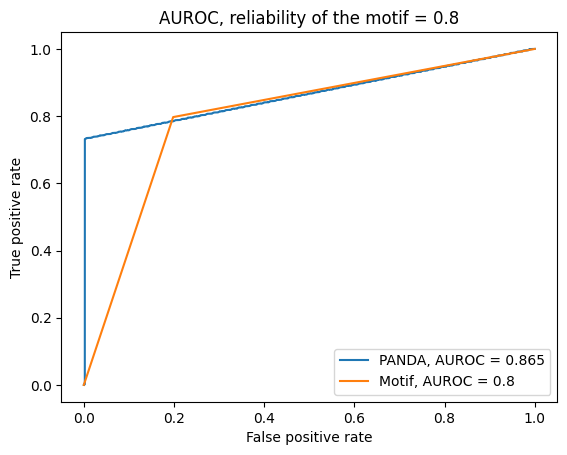

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -947.527049 -948.351542 -948.766939 -947.488431 -948.192261 -948.280198   
1   -949.333186 -949.096334 -950.216124 -949.897534 -950.689435 -949.021680   
2   -948.329327 -948.684808 -948.529918 -948.349196 -948.468430 -948.628920   
3   -950.631400 -949.429748 -949.545362 -951.167467 -950.038494 -950.885315   
4   -949.066353 -949.896905 -948.405645 -949.360231 -948.167792 -949.611564   
..          ...         ...         ...         ...         ...         ...   
495 -950.301772 -950.366253 -950.190763 -949.347220 -949.388428 -950.605229   
496 -951.078305 -951.105521 -950.218509 -950.425066 -950.716762 -

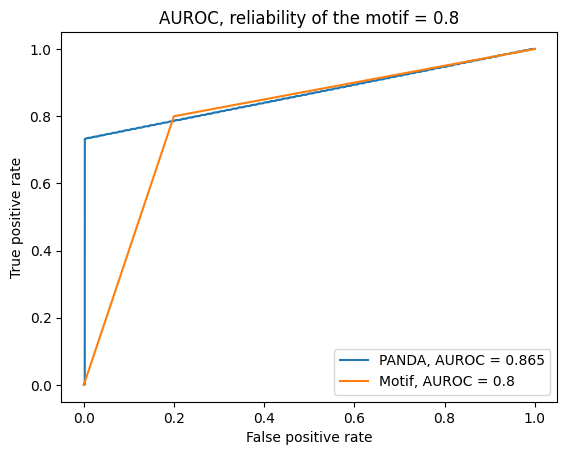

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -372.263819 -369.882424 -372.086191 -369.711036 -372.100390 -370.289121   
1   -371.648962 -371.884794 -371.052389 -370.981498 -372.017653 -371.151022   
2   -370.774055 -370.176232 -370.660788 -370.299357 -371.573233 -371.068557   
3   -372.664034 -371.369973 -371.572030 -372.551864 -372.224202 -372.114250   
4   -369.797120 -370.126409 -370.426426 -370.157807 -370.364873 -369.905813   
..          ...         ...         ...         ...         ...         ...   
495 -370.416490 -370.949218 -370.366143 -369.676461 -370.152086 -370.894409   
496 -370.838340 -370.658412 -370.835197 -370.607490 -371.262314 -

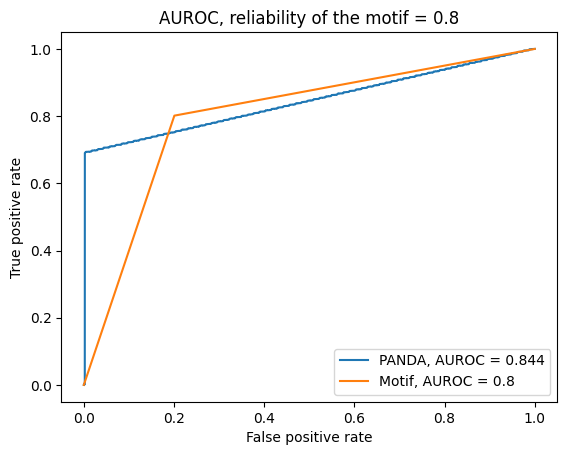

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -163.620455 -163.694678 -164.056966 -164.017419 -164.221190 -164.712870   
1   -164.844868 -165.316437 -166.631033 -163.978947 -166.606243 -164.679750   
2   -163.546553 -163.724495 -164.208126 -163.279444 -163.591826 -163.286317   
3   -164.024031 -163.598136 -163.885126 -163.318477 -163.189913 -162.885581   
4   -161.870958 -161.947214 -161.166589 -162.368045 -161.129880 -162.322197   
..          ...         ...         ...         ...         ...         ...   
495 -164.157628 -164.530771 -165.914305 -165.226286 -164.963387 -165.488282   
496 -164.903935 -165.133595 -164.940076 -165.087864 -165.343418 -

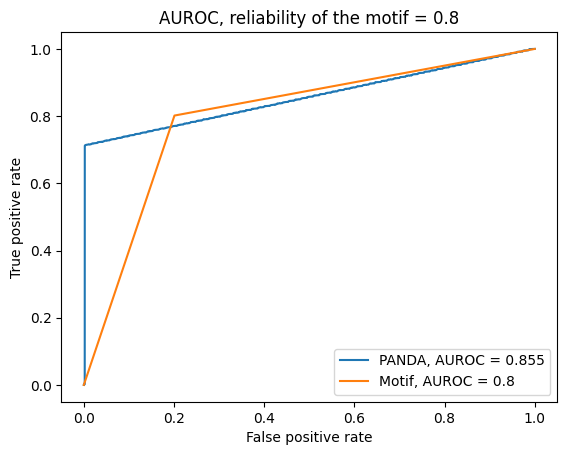

0.3
Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    226.343959  225.566048  226.046758  225.427868  226.113107  225.954335   
1    227.026705  227.704220  226.445117  227.061822  226.289156  226.959957   
2    224.631779  225.083263  224.807645  224.014287  224.989469  224.862191   
3    224.674561  225.917440  225.228108  226.027367  225.242686  225.541720   
4    224.887323  225.927954  225.463025  223.869118  225.265457  225.585788   
..          ...         ...         ...         ...         ...         ...   
495  223.689676  224.534433  222.451028  223.818796  221.872443  222.850637   
496  226.292686  226.460794  227.459978  226.660911  225.9689

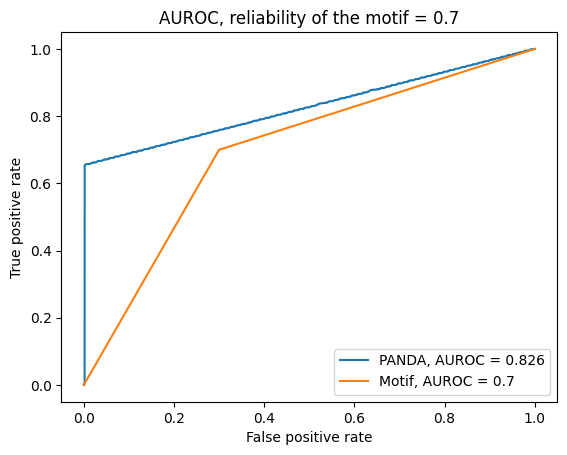

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -217.629677 -217.710375 -217.582471 -216.948635 -217.602513 -218.201198   
1   -216.550286 -216.890968 -216.468523 -216.683177 -216.842996 -216.945202   
2   -218.059924 -218.004322 -216.888654 -217.506974 -217.838386 -217.602622   
3   -217.120485 -217.056026 -217.173435 -216.774815 -217.488095 -216.484262   
4   -215.627259 -215.931241 -214.810539 -215.843384 -215.300471 -215.952112   
..          ...         ...         ...         ...         ...         ...   
495 -215.703444 -215.703262 -215.920784 -215.664546 -216.172989 -215.851498   
496 -216.531702 -218.351657 -217.447450 -218.339963 -217.696423 -

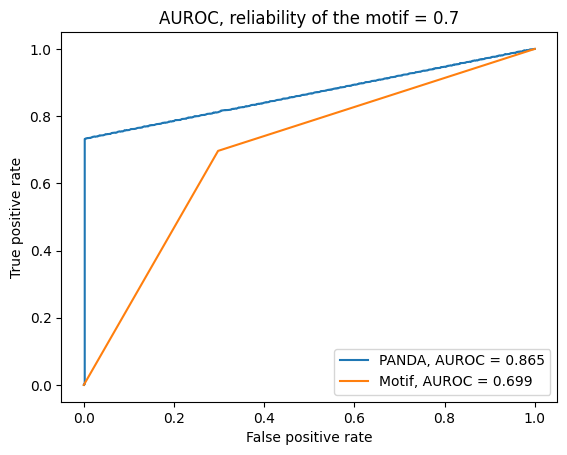

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    61.120349  61.778005  61.945810  62.190364  61.755988  61.669331   
1    63.596031  64.443739  62.795143  63.869123  62.537279  63.337424   
2    63.012817  63.399695  63.110273  64.162028  63.268147  63.686597   
3    62.727242  61.575847  60.802612  61.982240  62.656823  61.709739   
4    62.595197  62.163774  62.971086  62.741876  62.290286  62.340911   
..         ...        ...        ...        ...        ...        ...   
495  63.363293  62.668165  63.020364  63.047366  63.166805  62.914105   
496  64.999638  65.068366  66.018944  65.656788  64.439160  65.149909   
497  63.923027  63.981626  64.817249  63

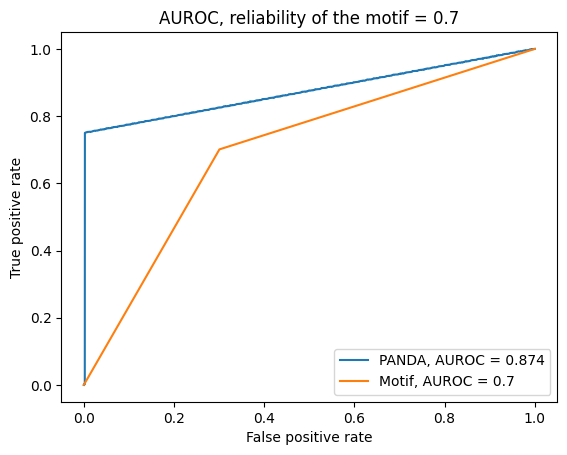

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    377.851906  377.494038  377.536289  377.960952  377.065867  377.632115   
1    376.363569  376.991388  376.966524  376.800617  376.815721  377.542021   
2    379.371596  379.134126  380.604021  379.563489  378.647016  378.611998   
3    377.490754  377.363062  377.008611  376.898901  375.933822  376.573610   
4    377.091645  377.584306  377.883668  376.539054  376.844830  375.928635   
..          ...         ...         ...         ...         ...         ...   
495  377.526581  377.348097  377.887139  377.675602  377.609537  377.244394   
496  378.489312  378.000345  378.422984  378.623923  377.800005  

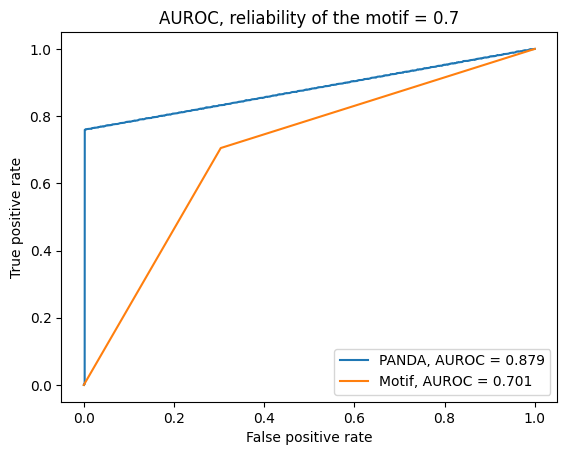

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -217.807886 -219.448659 -219.152160 -219.429721 -218.913453 -218.784298   
1   -217.848784 -218.933896 -218.400833 -218.404095 -217.871523 -218.515562   
2   -219.099639 -218.593054 -217.814692 -219.175311 -218.652314 -219.218707   
3   -220.109295 -219.195154 -219.525043 -219.651299 -219.716330 -219.557088   
4   -220.308660 -220.438836 -220.944695 -219.943218 -220.978146 -219.779536   
..          ...         ...         ...         ...         ...         ...   
495 -218.287530 -218.176482 -217.393165 -218.055504 -218.761557 -217.028773   
496 -218.209551 -218.133878 -218.966826 -218.314266 -218.820373 -

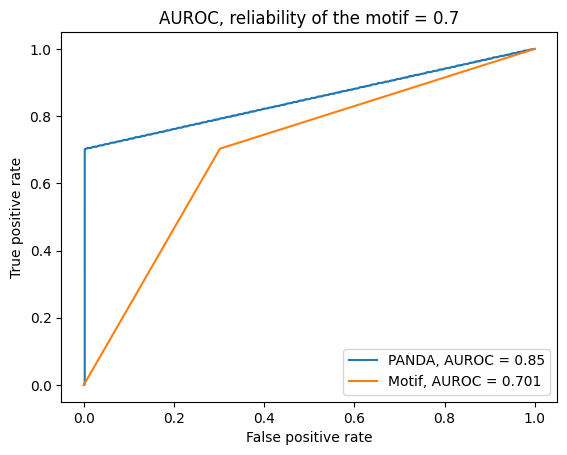

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 222
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -899.246966 -899.453858 -899.794089 -899.246478 -899.678174 -899.304784   
1   -900.443592 -900.268838 -899.578010 -899.346996 -899.814765 -900.362699   
2   -900.890845 -901.208634 -900.825732 -901.513233 -901.686679 -902.576473   
3   -902.092530 -901.912646 -901.817639 -901.768031 -900.892925 -901.904829   
4   -899.706655 -899.644043 -899.698504 -899.943172 -899.957934 -901.272685   
..          ...         ...         ...         ...         ...         ...   
495 -902.239598 -901.990661 -903.059108 -902.673815 -903.082363 -901.487356   
496 -898.569627 -900.113714 -899.460045 -899.776088 -900.088862 -

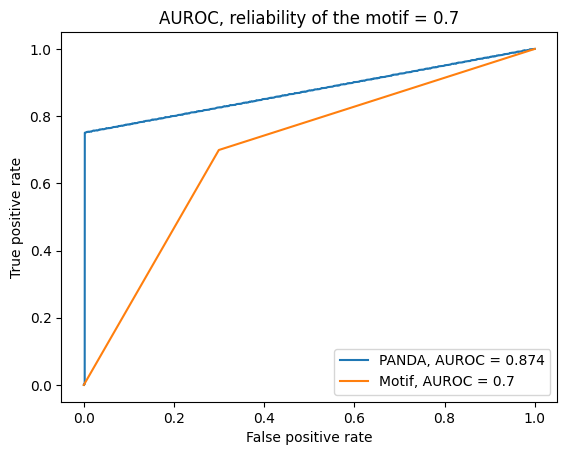

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 222
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt               0            1            2            3            4   \
0    1120.962640  1119.670214  1120.177476  1120.556334  1121.062195   
1    1121.528567  1121.404108  1122.665771  1122.203878  1122.114553   
2    1121.858091  1122.325561  1123.062070  1122.234507  1121.845630   
3    1122.481841  1121.402868  1123.106500  1121.785823  1122.211809   
4    1121.255780  1121.630406  1121.154468  1121.584987  1121.372612   
..           ...          ...          ...          ...          ...   
495  1122.518602  1122.194331  1121.894289  1122.006976  1122.035035   
496  1121.132797  1121.194454  1120.879221  1121.504196  1120.725601   
497  1120.852232  1120.191180  1120.785381  1122.

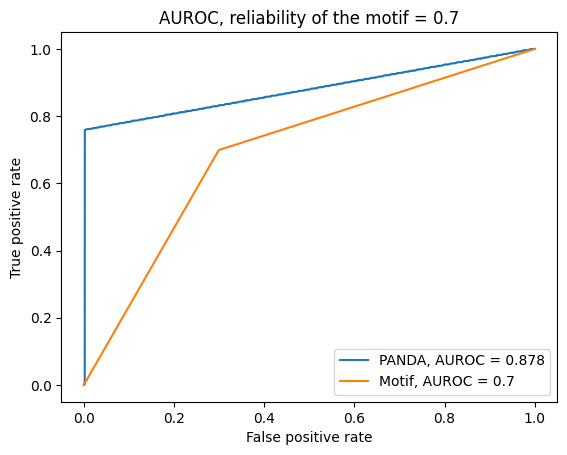

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -215.919717 -217.100641 -215.853239 -218.134712 -218.210992 -215.937507   
1   -217.088141 -216.743983 -216.190710 -216.271424 -216.540318 -215.766987   
2   -217.122937 -217.075112 -217.220533 -217.288621 -217.633270 -215.382171   
3   -216.503054 -216.720031 -215.806439 -215.752508 -215.607048 -216.927388   
4   -218.054694 -218.243483 -218.320795 -220.295047 -219.449737 -219.674408   
..          ...         ...         ...         ...         ...         ...   
495 -217.173513 -217.809644 -217.267195 -216.610058 -218.243721 -217.718674   
496 -218.828026 -218.472774 -219.057945 -218.824224 -217.897948 -

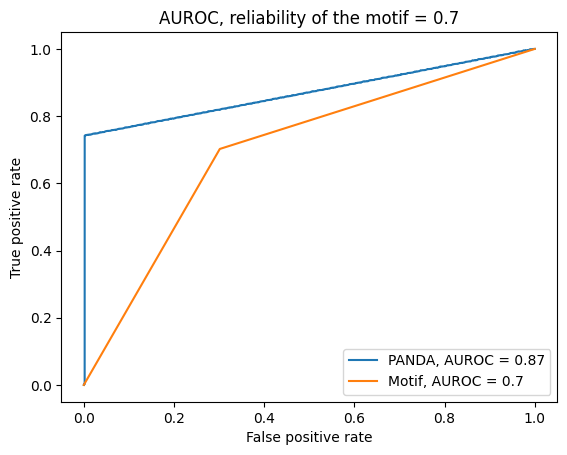

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    318.348517  316.939483  318.556998  318.436149  316.984249  318.162919   
1    314.006129  315.123269  314.602619  314.799490  315.873233  314.651077   
2    318.703674  316.933885  317.243400  317.151154  317.300408  317.096314   
3    316.744911  317.295886  318.099507  317.369018  316.303329  317.035783   
4    316.676230  315.330556  315.990287  315.336544  316.140988  315.259234   
..          ...         ...         ...         ...         ...         ...   
495  317.147675  316.475389  316.383749  317.159631  316.957609  315.970327   
496  315.046864  316.270504  316.222421  315.327472  316.827683  

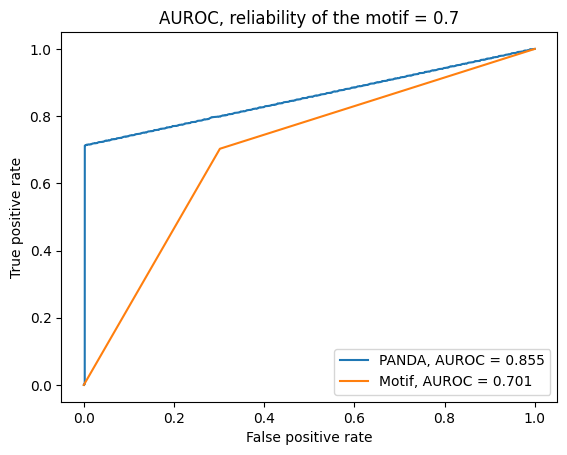

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    470.591178  470.871169  471.657363  471.564308  470.313082  470.787160   
1    470.961006  470.803423  471.070116  471.199929  471.559465  472.005444   
2    472.664504  472.008319  471.896619  471.599268  471.470889  471.465722   
3    472.966732  472.889664  473.590448  473.814594  473.151411  474.028995   
4    473.344542  474.213745  473.528898  473.860744  473.577963  474.792036   
..          ...         ...         ...         ...         ...         ...   
495  473.568173  474.288416  473.982240  475.375571  474.792452  473.951151   
496  473.259593  472.546215  473.780120  473.628094  473.179480  

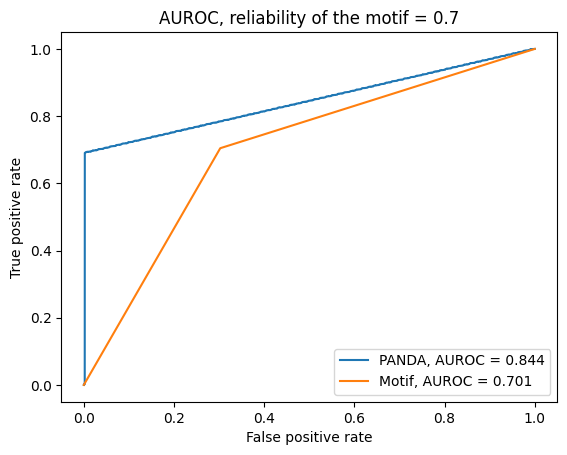

0.4
Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    195.630770  194.827305  194.988530  194.347798  194.855306  194.545919   
1    193.248082  193.722115  193.147005  194.054916  193.084341  192.630513   
2    195.543097  194.743232  195.887768  194.654604  194.706161  196.234758   
3    193.273969  192.695924  193.575944  192.829105  193.349783  193.964471   
4    193.255679  193.582053  194.373208  193.223677  194.173745  194.097248   
..          ...         ...         ...         ...         ...         ...   
495  194.732576  194.900762  194.828825  194.914533  193.547084  194.527445   
496  194.110832  193.676822  193.657846  194.360017  193.9333

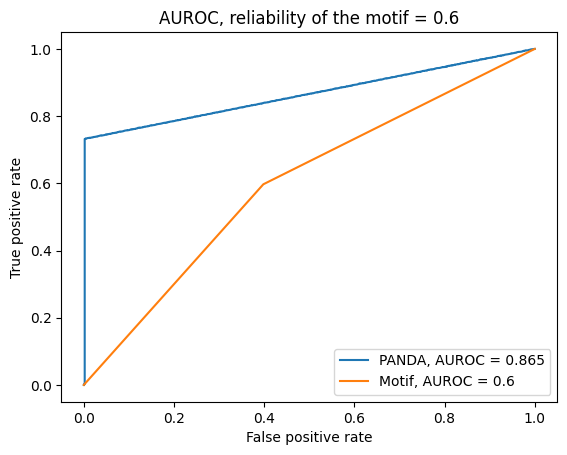

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 216
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -711.135585 -712.034946 -711.886736 -711.894656 -712.370087 -711.294689   
1   -712.970764 -713.485574 -712.820305 -712.884958 -713.385398 -713.868246   
2   -712.949309 -713.818416 -713.546823 -713.538087 -712.755770 -714.001445   
3   -713.895867 -713.623404 -712.976290 -712.167759 -712.580152 -713.174455   
4   -712.086815 -712.725569 -712.909556 -712.909582 -711.875416 -711.922359   
..          ...         ...         ...         ...         ...         ...   
495 -712.475938 -712.472201 -712.014621 -712.968674 -712.205679 -712.904900   
496 -715.034639 -714.989918 -715.091487 -715.731269 -715.767810 -

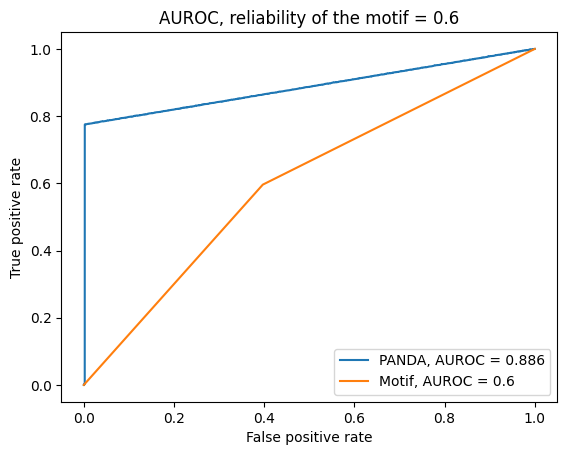

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.03 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -363.568416 -363.089933 -363.686572 -362.892165 -362.820600 -365.354192   
1   -364.697631 -364.662482 -365.666563 -364.741852 -365.475403 -365.297125   
2   -362.521326 -363.983675 -364.589126 -363.160320 -364.176767 -362.677382   
3   -363.853595 -365.131343 -365.647918 -364.900664 -365.127671 -364.326164   
4   -363.761605 -363.756288 -362.576333 -363.389465 -362.922673 -363.729931   
..          ...         ...         ...         ...         ...         ...   
495 -362.097912 -362.107384 -362.351438 -361.777178 -362.991717 -363.368280   
496 -365.866114 -364.445162 -362.690166 -364.856907 -365.623111 -

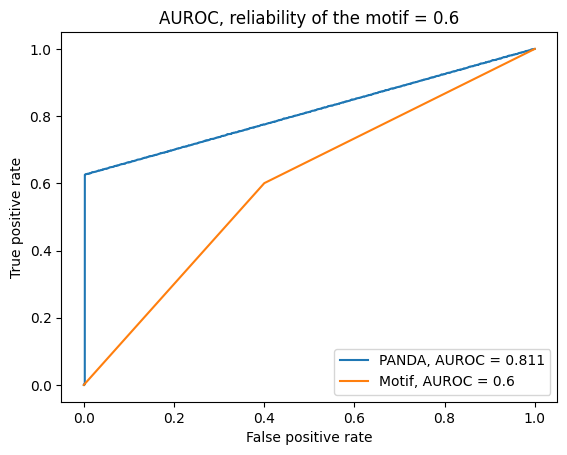

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    123.672247  123.502950  122.691670  123.067387  124.171370  122.728638   
1    122.094594  121.965692  123.053301  122.464851  123.027182  122.097391   
2    124.862320  125.456180  127.027213  125.383072  125.129061  125.539896   
3    122.942154  124.825730  124.368311  124.925236  124.984231  125.145562   
4    121.662374  121.703685  122.331094  122.770645  121.912678  122.252892   
..          ...         ...         ...         ...         ...         ...   
495  124.763511  124.476918  125.464246  125.643268  124.536368  124.716842   
496  124.422748  124.590062  124.426278  124.726865  123.464434  

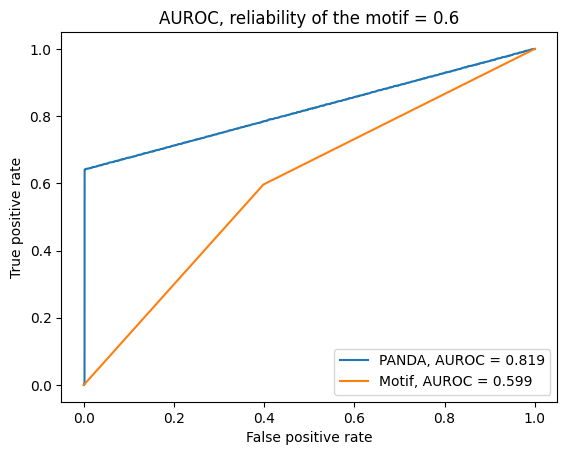

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -336.388391 -337.164731 -337.770510 -336.934102 -337.748927 -338.737959   
1   -336.846101 -336.499036 -337.079847 -337.161409 -336.035457 -336.956363   
2   -335.755655 -335.443510 -335.313852 -335.464457 -336.377859 -335.877149   
3   -338.100530 -337.913957 -338.897169 -337.315162 -337.334741 -338.250726   
4   -337.823963 -337.017441 -336.568240 -336.166319 -336.130651 -336.455900   
..          ...         ...         ...         ...         ...         ...   
495 -335.541176 -336.278491 -335.557173 -336.084744 -336.537360 -335.429652   
496 -334.875151 -336.532604 -336.391841 -336.365895 -334.865571 -

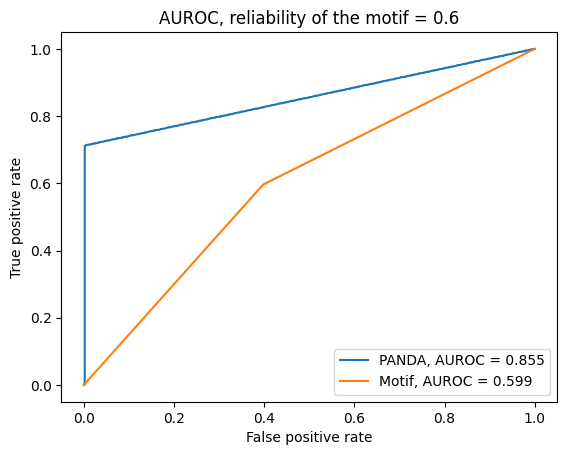

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 224
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -429.232079 -429.139527 -429.482676 -429.554153 -429.229314 -428.300021   
1   -427.784396 -427.896519 -426.971233 -428.103759 -428.010743 -428.736160   
2   -427.262691 -428.074710 -427.644388 -428.143326 -428.895919 -427.549243   
3   -428.379014 -428.884968 -427.487157 -427.683555 -427.696570 -427.420680   
4   -428.981759 -428.571381 -427.205524 -428.095020 -428.232125 -428.480888   
..          ...         ...         ...         ...         ...         ...   
495 -427.241420 -429.223455 -427.842606 -427.638218 -428.540858 -428.393695   
496 -429.190613 -428.749550 -429.439246 -428.040612 -428.380174 -

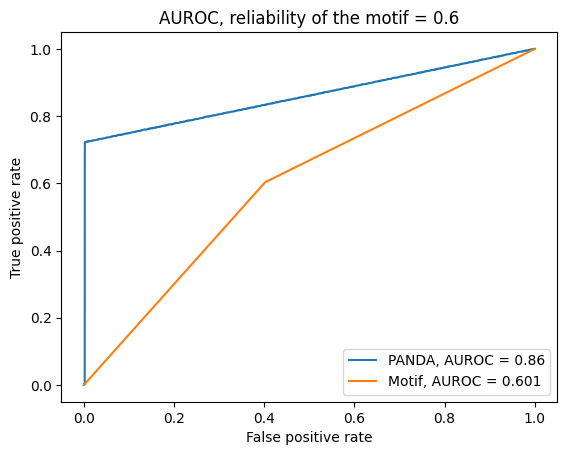

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    228.931021  229.705189  228.563584  229.762524  229.037750  228.373091   
1    229.524073  229.782823  230.286798  229.132896  229.819845  230.134482   
2    229.848392  230.195731  229.434874  229.769042  229.653097  229.755462   
3    230.045187  229.514143  229.855282  231.161127  230.472039  230.591179   
4    228.209577  227.651938  229.097279  227.747605  228.467187  229.769744   
..          ...         ...         ...         ...         ...         ...   
495  230.820177  230.325547  230.667612  230.517301  230.511521  230.403484   
496  230.630136  231.226857  229.541316  230.042217  230.872692  

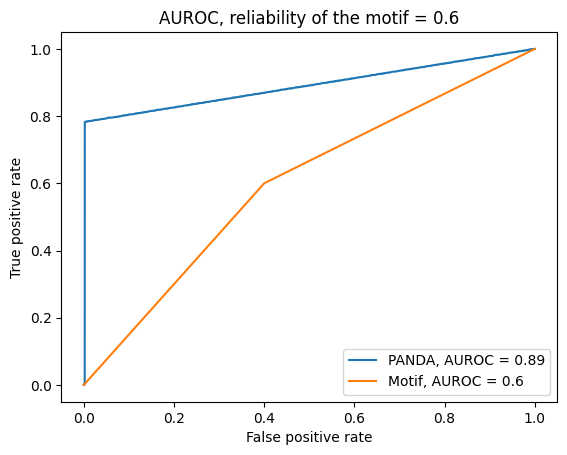

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    668.172624  667.854880  668.084912  668.494193  668.244186  668.428881   
1    668.262201  667.482271  667.487254  666.933860  668.708564  667.218783   
2    667.718919  668.140109  668.074579  666.620917  668.201107  666.885755   
3    669.302759  668.000922  668.397506  668.689270  669.376334  668.621707   
4    669.438450  670.285805  669.949428  669.624017  669.352365  668.921823   
..          ...         ...         ...         ...         ...         ...   
495  667.370075  669.427742  668.274293  667.354371  668.171210  669.074111   
496  670.336809  670.774566  670.010240  669.779118  670.670771  

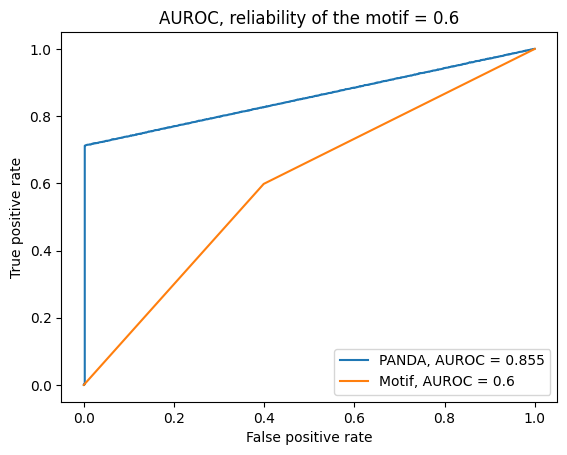

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 154
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -7.932431 -7.886088 -7.947881 -7.084488 -7.802033 -7.257208 -7.085691   
1   -8.400188 -7.713958 -7.862056 -7.864079 -7.895273 -8.813723 -7.547260   
2   -6.442405 -7.553115 -7.022751 -7.144712 -6.885698 -6.890112 -6.556206   
3   -9.459363 -7.898026 -8.179302 -8.651909 -7.602816 -9.154679 -8.139423   
4   -6.546933 -7.084416 -6.203578 -7.273128 -6.442963 -6.649869 -5.641593   
..        ...       ...       ...       ...       ...       ...       ...   
495 -7.841338 -7.283043 -7.588176 -8.380181 -8.236439 -6.865297 -7.986739   
496 -7.187297 -8.686432 -8.411480 -6.714167 -8.418089 -7.578219 -9.100934   
497 

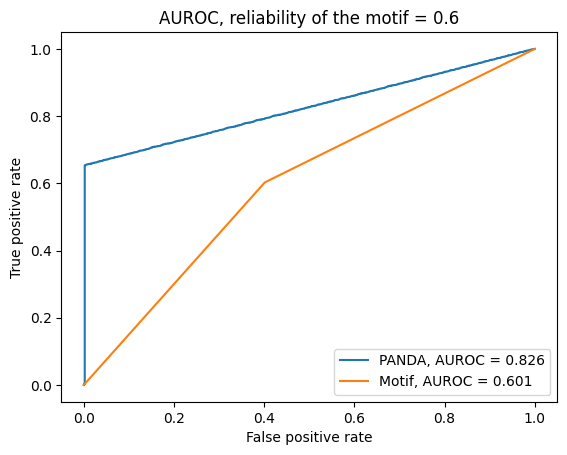

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0   -61.543413 -62.073157 -61.876410 -61.666972 -60.736228 -62.253884   
1   -62.057467 -61.243595 -60.257358 -61.606233 -61.768240 -63.038410   
2   -61.873884 -62.810778 -61.825439 -61.913565 -61.727529 -62.509406   
3   -62.304607 -62.071538 -62.447839 -61.703248 -61.854323 -61.499501   
4   -62.526777 -61.346279 -63.174094 -63.322221 -62.695911 -63.352190   
..         ...        ...        ...        ...        ...        ...   
495 -62.846895 -63.029525 -62.978928 -62.585592 -62.797219 -62.915220   
496 -63.125852 -62.105183 -62.797496 -63.484255 -63.368807 -62.866286   
497 -61.791643 -61.397795 -61.051808 -61

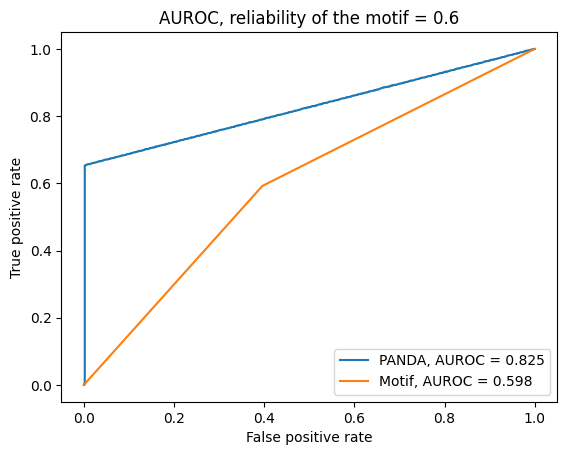

0.5
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    19.647495  19.609170  19.953504  19.198926  19.350663  19.142906   
1    18.035749  18.584175  19.480460  17.476229  18.471246  18.169466   
2    16.149494  17.263332  18.218544  16.365119  17.737516  18.256683   
3    19.421658  19.474719  21.267394  18.950242  20.393595  20.833411   
4    18.523653  17.839262  17.692452  18.271655  17.694748  17.820553   
..         ...        ...        ...        ...        ...        ...   
495  18.806198  17.895522  19.123654  18.349955  18.392725  18.799165   
496  20.173647  20.156055  20.356593  21.314992  20.674943  20.406112   
497  19.180260  20.418918  20.025394

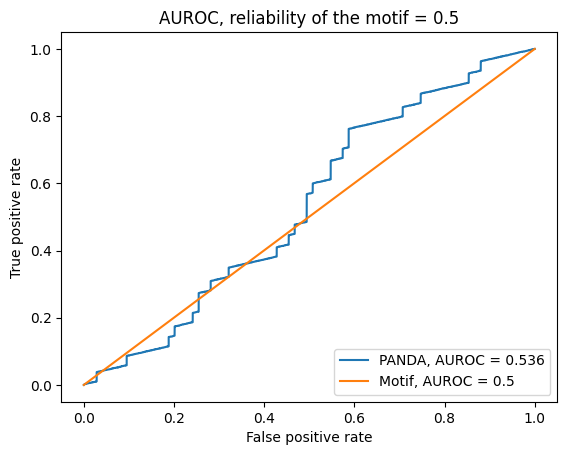

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    114.377608  114.654827  114.373479  114.280232  114.397723  113.892961   
1    115.335636  115.412528  115.331904  115.237452  115.508747  115.436864   
2    115.037163  115.411390  115.488581  114.759435  114.231600  115.039662   
3    113.970461  113.275774  114.887798  114.725573  114.930121  114.702656   
4    113.779035  114.757195  113.541586  113.886193  113.857868  114.186529   
..          ...         ...         ...         ...         ...         ...   
495  116.617767  115.567012  115.895690  115.619121  115.178203  115.400090   
496  116.521914  115.661161  115.672723  115.589996  115.956925  

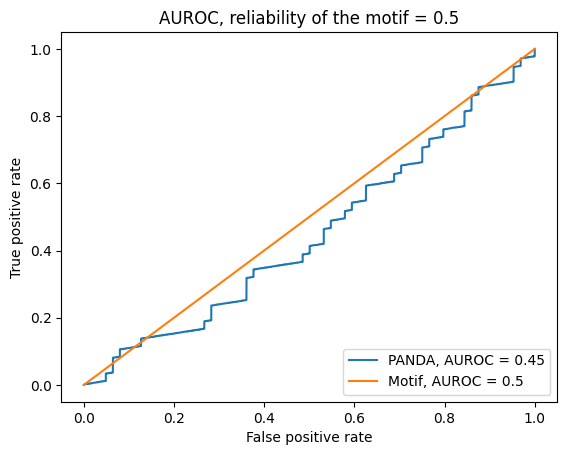

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -180.796107 -178.802420 -178.885273 -178.860992 -178.687511 -180.037457   
1   -181.860443 -181.935532 -181.994853 -180.945641 -181.917792 -182.019966   
2   -180.453706 -180.376162 -180.177548 -179.982250 -179.646423 -180.228678   
3   -181.929296 -181.795188 -182.716196 -181.629964 -182.123007 -181.840277   
4   -181.331822 -180.097377 -180.431659 -180.883951 -181.042316 -181.272967   
..          ...         ...         ...         ...         ...         ...   
495 -182.796529 -181.782561 -181.835259 -182.211736 -182.522942 -182.966997   
496 -179.921485 -179.963925 -180.791180 -179.497503 -178.684891 -

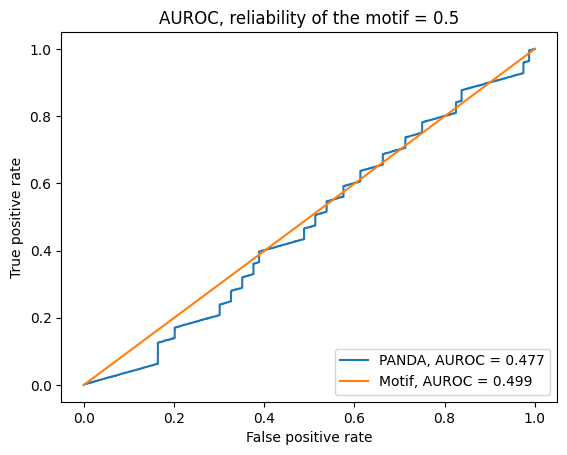

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.03 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -634.491386 -633.901809 -634.708581 -634.867393 -634.690498 -635.158533   
1   -636.171376 -635.484242 -635.683414 -636.337306 -635.971957 -635.567403   
2   -637.680578 -636.561153 -637.400497 -637.055344 -637.132619 -636.796413   
3   -634.865682 -634.940037 -634.321780 -634.016353 -634.065312 -633.760795   
4   -636.179861 -636.433462 -636.648394 -635.472682 -636.114520 -637.248453   
..          ...         ...         ...         ...         ...         ...   
495 -635.731190 -635.309725 -637.341294 -636.496012 -637.049030 -637.205152   
496 -634.970921 -635.229748 -635.079608 -635.657833 -635.500676 -

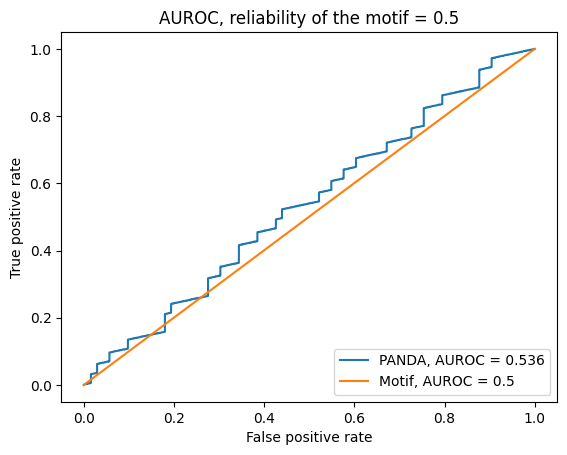

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -800.275063 -800.520118 -799.632984 -800.627885 -800.678707 -799.805561   
1   -799.131099 -799.076244 -798.514027 -799.092164 -798.971389 -799.695455   
2   -798.554114 -799.082265 -799.054054 -798.978743 -799.391304 -799.015079   
3   -801.822042 -801.982827 -802.221271 -803.317913 -802.492341 -801.722115   
4   -798.320437 -798.674484 -799.106757 -798.927247 -799.291902 -799.046255   
..          ...         ...         ...         ...         ...         ...   
495 -798.436322 -798.891746 -798.717095 -797.620318 -798.857559 -798.381399   
496 -798.996340 -798.784971 -798.728841 -798.371745 -799.028323 -

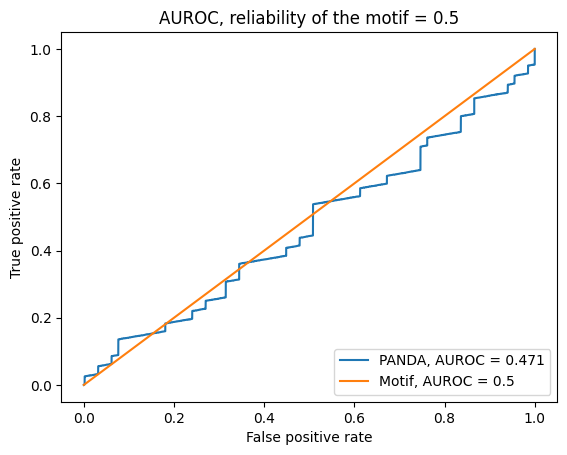

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.03 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    261.947738  259.946736  260.561971  261.396475  262.007551  261.842586   
1    263.328059  262.825057  263.715522  263.510883  263.487334  263.188761   
2    261.468003  261.365551  261.333220  260.597331  261.190398  261.306049   
3    263.867999  263.951279  263.546921  262.130625  263.007371  262.568681   
4    261.577872  260.976084  261.022399  262.056839  261.359544  261.069788   
..          ...         ...         ...         ...         ...         ...   
495  261.179870  262.465140  262.569861  262.849914  262.671834  261.961412   
496  263.438975  262.893947  263.805100  264.366747  264.413454  

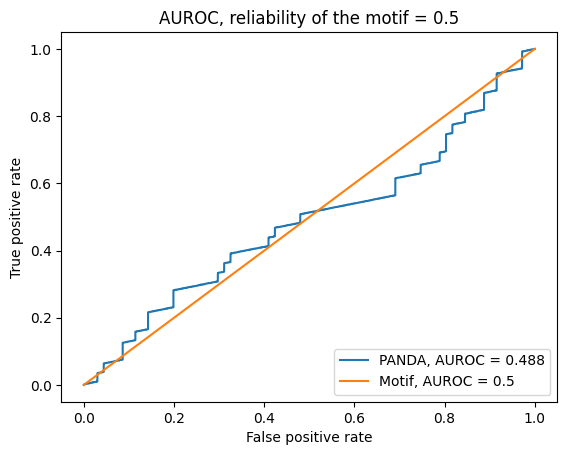

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -144.099993 -144.161825 -143.897377 -143.962826 -143.773997 -143.989508   
1   -145.101719 -144.859706 -144.257697 -143.901391 -144.088803 -144.177350   
2   -145.353121 -145.841400 -143.539314 -144.698573 -143.956835 -145.283776   
3   -142.760963 -142.303637 -141.491763 -142.672227 -142.231064 -141.542329   
4   -144.317549 -144.309293 -144.582691 -144.653486 -144.774728 -144.590003   
..          ...         ...         ...         ...         ...         ...   
495 -143.842826 -144.056845 -144.581015 -143.266517 -143.612980 -143.205010   
496 -145.380658 -144.856156 -143.925648 -145.450853 -145.792443 -

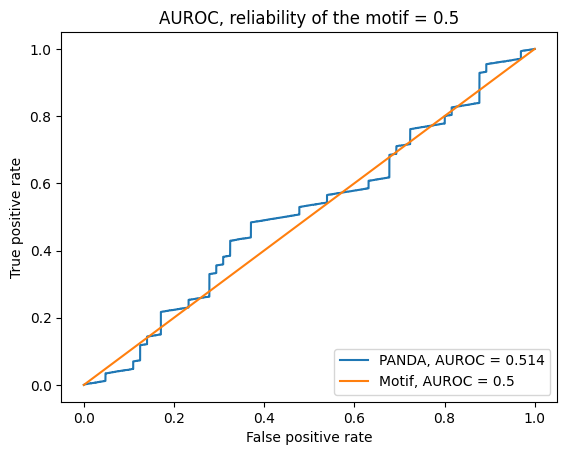

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0    156.517618  155.371339  157.356869  155.933296  156.293119  155.468816   
1    156.364078  155.768830  155.746480  155.595567  155.743695  154.751639   
2    155.172211  154.735383  155.279027  154.976322  154.979209  156.652566   
3    157.525353  157.725743  156.404273  157.174017  156.573016  156.472555   
4    154.728206  153.957914  154.593468  154.303742  153.857981  153.992771   
..          ...         ...         ...         ...         ...         ...   
495  157.615687  158.763010  157.234688  157.602829  156.660962  157.383079   
496  157.448585  157.510248  157.095078  157.180792  158.720423  

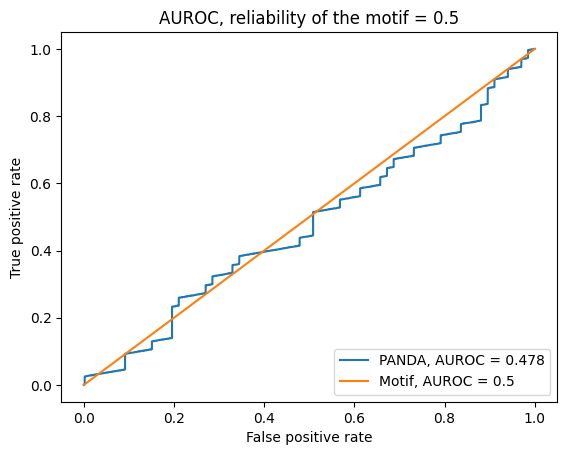

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 244
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -160.056079 -159.812732 -159.772488 -159.981337 -160.781220 -159.659319   
1   -160.804779 -161.021765 -160.496551 -160.893150 -159.992621 -160.345340   
2   -158.903332 -161.492029 -160.461172 -159.898284 -160.306351 -159.437391   
3   -163.613955 -162.488975 -161.148810 -161.656082 -162.641128 -161.852161   
4   -160.509547 -159.904148 -159.874751 -160.145887 -159.265950 -160.519242   
..          ...         ...         ...         ...         ...         ...   
495 -161.540159 -161.338847 -161.504392 -161.015334 -161.453016 -160.639587   
496 -160.324317 -160.186838 -160.178992 -160.004548 -160.940004 -

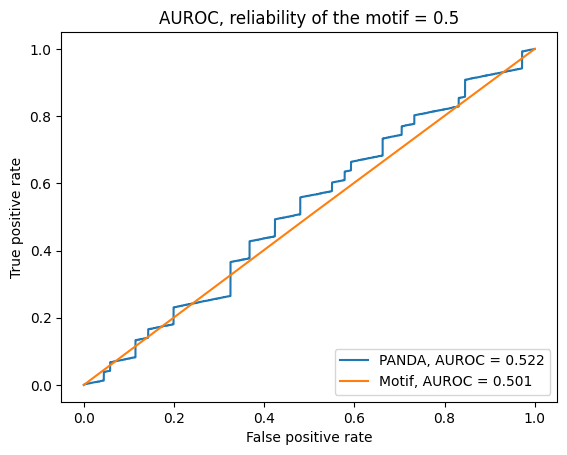

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.02 sec.
Creating motif network ...
  Elapsed time: 0.02 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt              0           1           2           3           4           5   \
0   -255.349977 -257.019075 -255.332260 -255.542755 -256.656955 -257.098147   
1   -259.993441 -259.154256 -258.311873 -260.399322 -257.572989 -258.377060   
2   -255.543124 -254.592425 -254.548647 -256.713652 -255.993432 -256.210423   
3   -257.840975 -258.147441 -258.640202 -257.532541 -257.710048 -257.840274   
4   -257.128952 -258.167930 -258.370076 -258.396403 -258.393251 -260.180017   
..          ...         ...         ...         ...         ...         ...   
495 -258.338231 -258.397287 -258.696766 -258.654717 -258.755420 -259.385525   
496 -257.701580 -257.167133 -257.799211 -257.463263 -257.646368 -

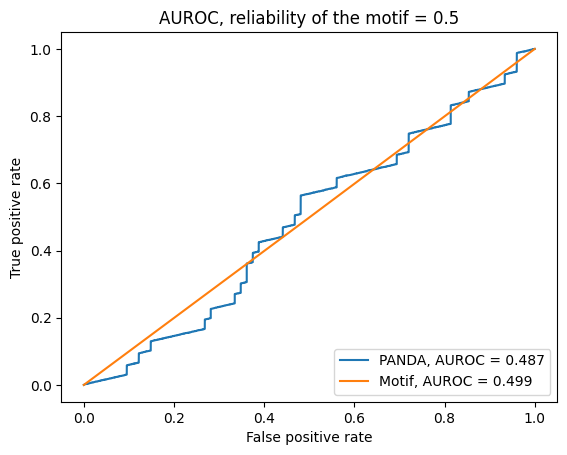

Prior reliability 0.99: mean 0.8592000000000001, sd 0.025813949717158766
Prior reliability 0.9: mean 0.8638999999999999, sd 0.009833107342035892
Prior reliability 0.8: mean 0.8554, sd 0.025675669416784466
Prior reliability 0.7: mean 0.8615, sd 0.016481808153233687
Prior reliability 0.6: mean 0.8492, sd 0.026358300400443128
Prior reliability 0.5: mean 0.49590000000000006, sd 0.027876334048794884


In [18]:
def simulation(n = 25, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    
    R_panda = notebooks.compute_panda_locally(gene_expression, motif, ppi)
    return notebooks.plot_auroc(R, [R_panda, motif], ["PANDA", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 10
res_panda = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    print(shuffle)
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_panda.keys():
            res_panda[shuffle] += [score]
        else:
            res_panda[shuffle] = [score]
for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_panda[shuffle])}, sd {np.std(res_panda[shuffle])}")

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

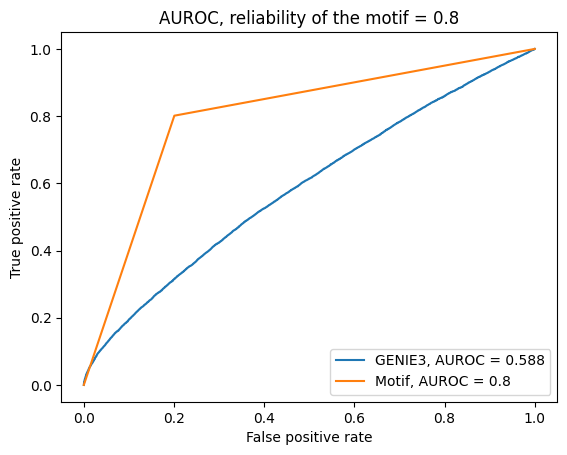

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

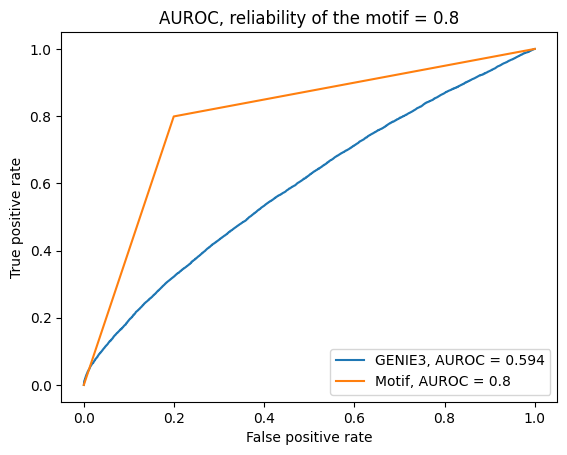

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

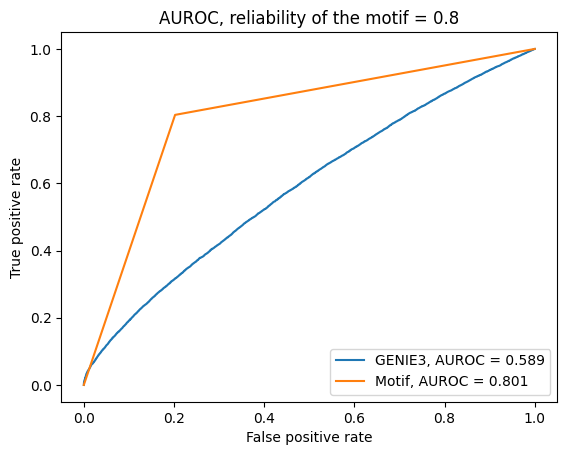

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

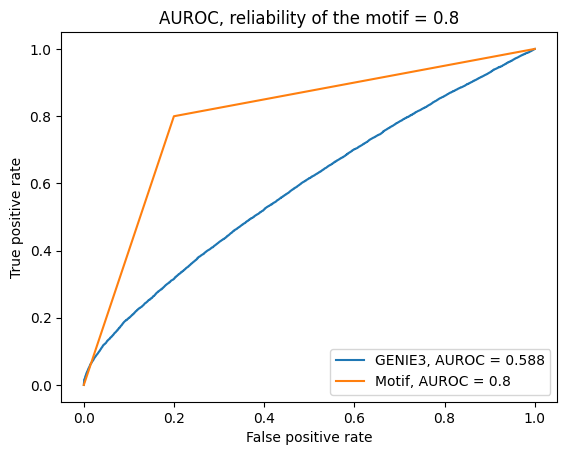

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

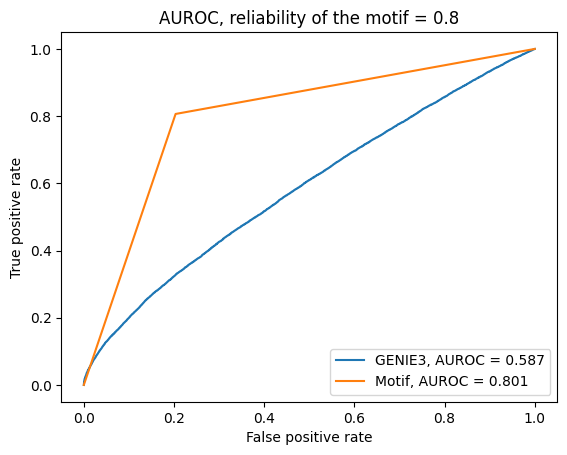

In [25]:
def simulation(n = 25, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)

    model = notebooks.GENIE3((np.vstack([gene_expression, TFA]) + np.random.uniform(0, 1e-3, (600, 25))).T)[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["GENIE3", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 5
res_genie = []
for i in range(B):
    score = simulation()[0]
    res_genie += [score]

In [26]:
print(f"Mean {np.mean(res_genie)}, sd {np.std(res_genie)}")

Mean 0.5892, sd 0.0024819347291981735


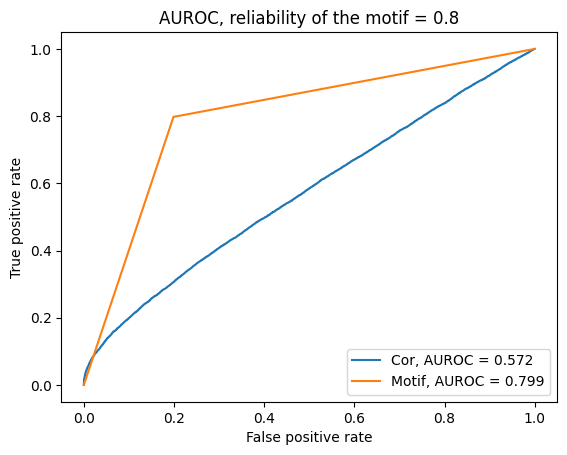

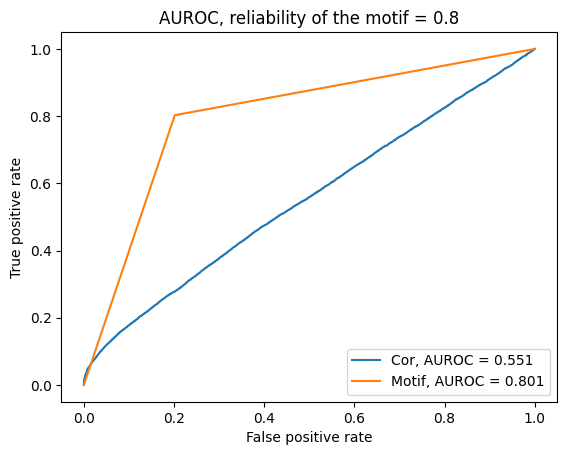

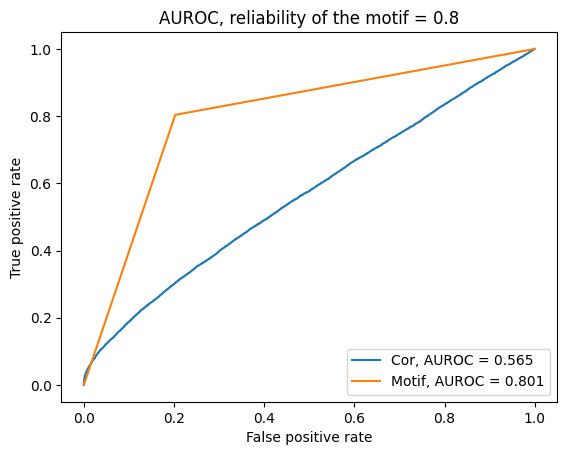

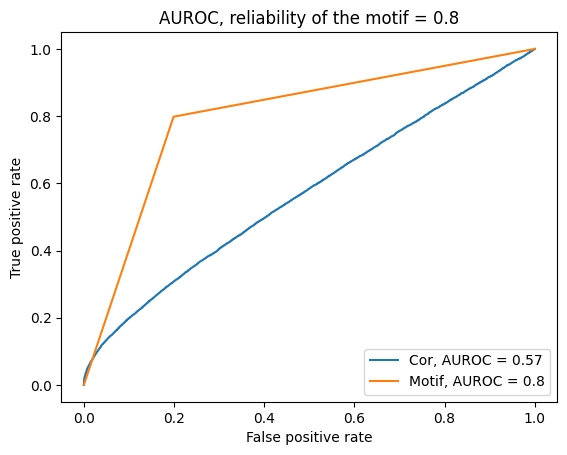

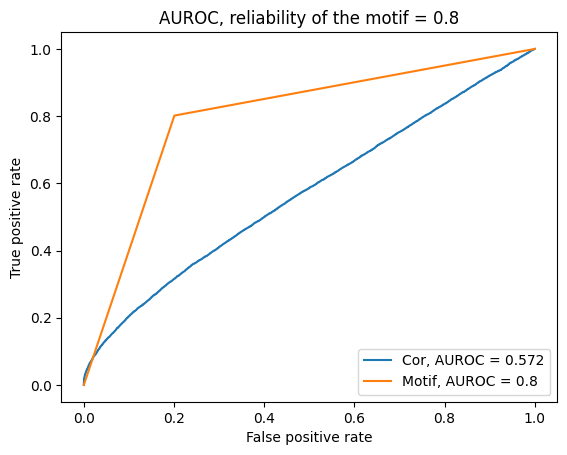

...

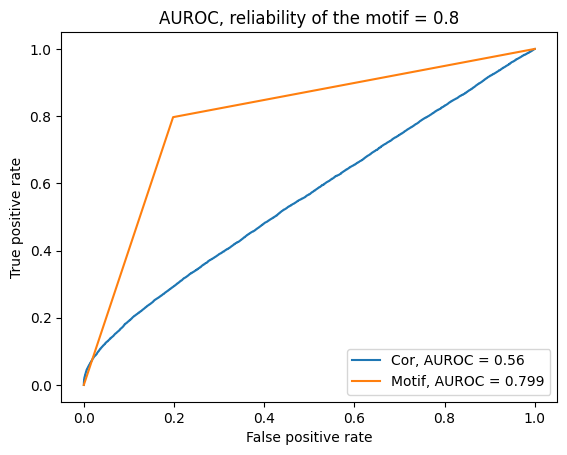

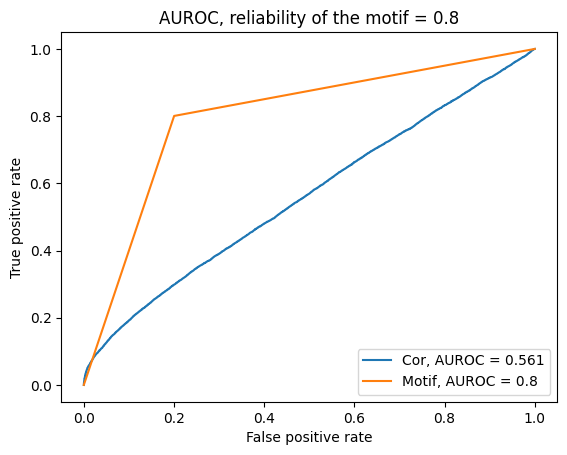

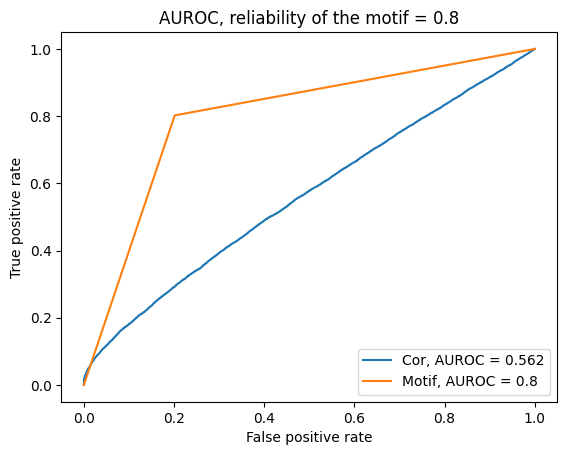

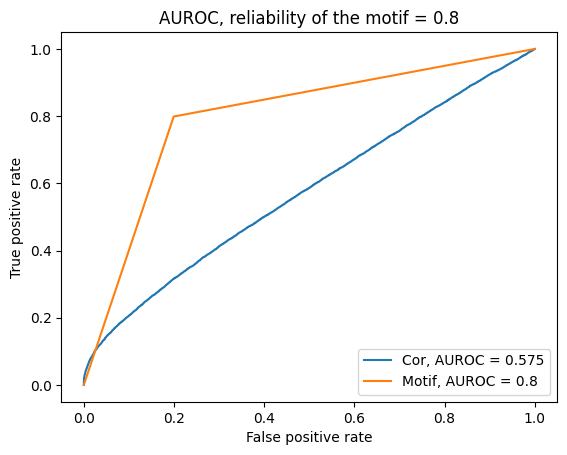

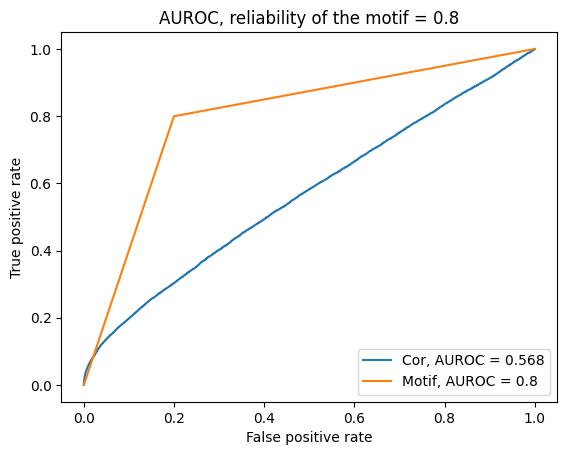

Mean 0.55946, sd 0.009587929912134287


In [22]:
def simulation(n = 25, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)

    model = np.corrcoef((np.vstack([gene_expression, TFA]) + np.random.uniform(0, 1e-6, (600, 25))))[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["Cor", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 50
res_cor = []
for i in range(B):
    score = simulation()[0]
    res_cor += [score]

print(f"Mean {np.mean(res_cor)}, sd {np.std(res_cor)}")

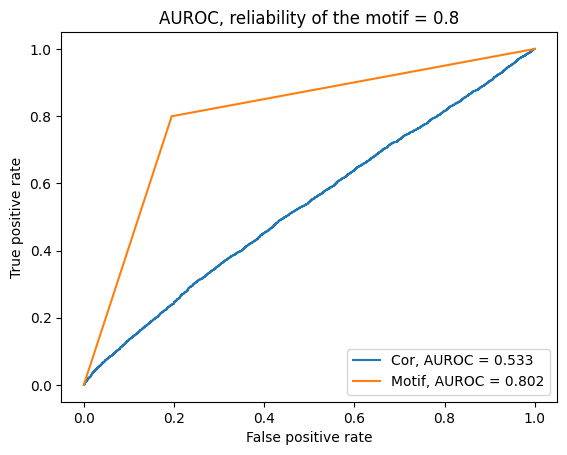

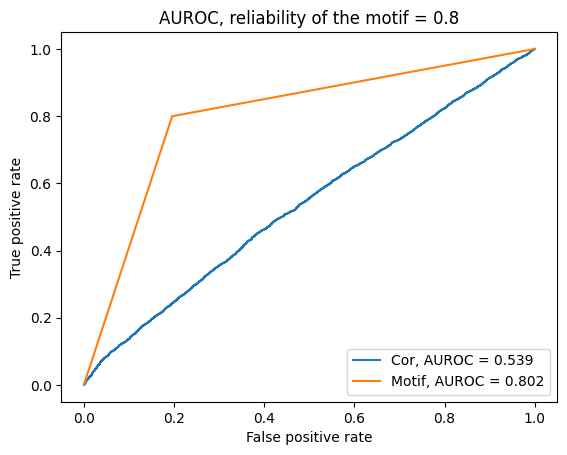

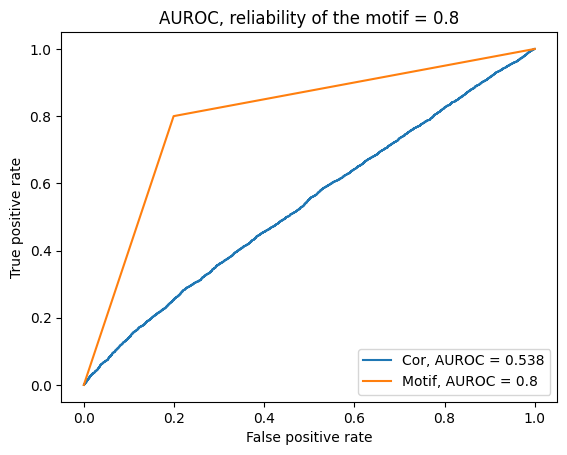

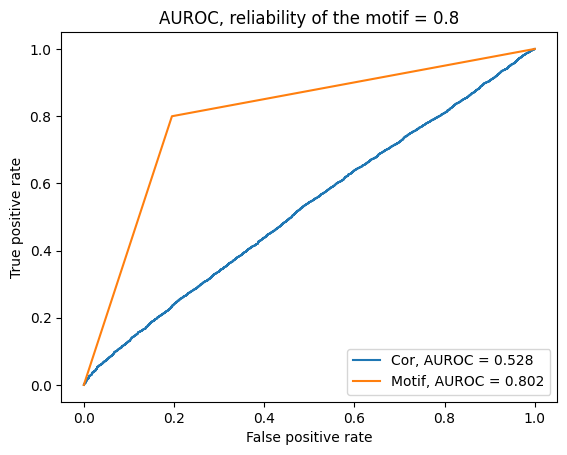

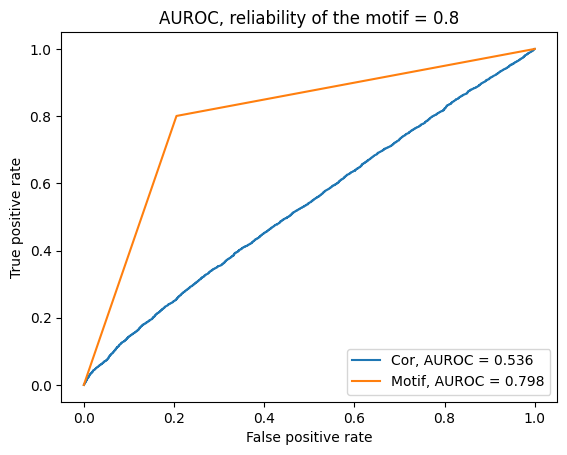

...

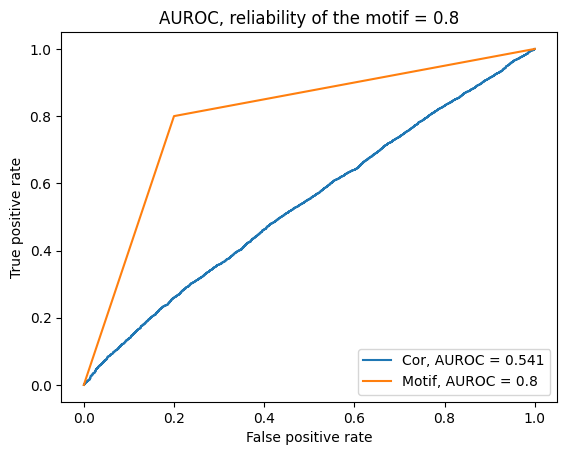

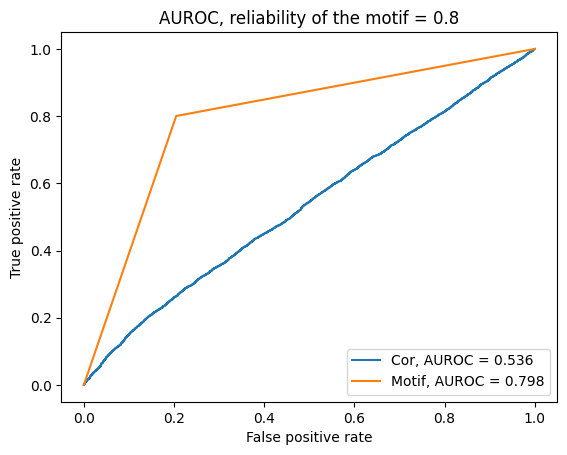

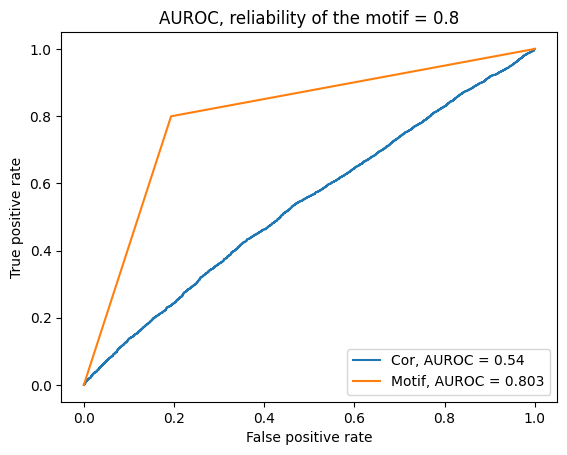

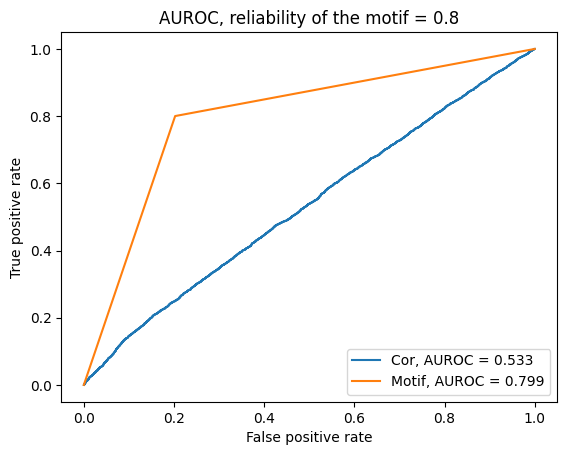

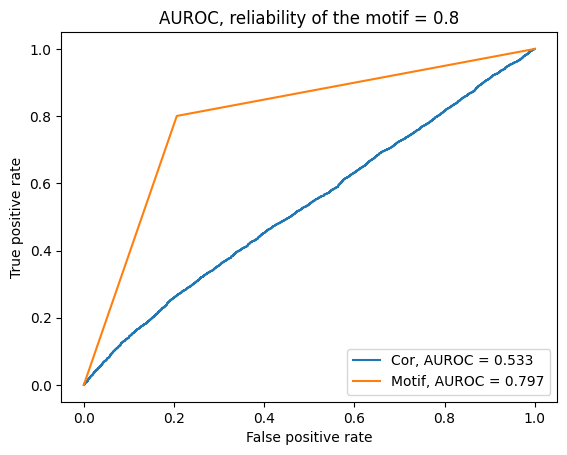

Mean 0.53734, sd 0.004671659234147974


In [23]:
def simulation(n = 25, shuffling = 0.2, sparsity = .9, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    C = np.abs(np.corrcoef((np.vstack([gene_expression, TFA])) + np.random.uniform(0, 1e-6, (600, 25))))
    b = 8
    model = (((C ** b) + (C ** b).T) / 2)[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["Cor", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

B = 50
res_wgcna = []
for i in range(B):
    score = simulation()[0]
    res_wgcna += [score]

print(f"Mean {np.mean(res_wgcna)}, sd {np.std(res_wgcna)}")